**<h1 align="center" font="bold">New York City Taxi Fare Prediction</font></h1>**

### <font color='289C4E'>Table of contents<font><a class='anchor' id='top'></a>
* [Introduction : Taxi Fare Prediction](#Introduction-:-Taxi-Fare-Prediction)
  * [Objective](http://)
  * [Data Dictionary](#Data-Dictionary)   
* [Data Exploration](#Data-Exploration)
     * [Profile Report](#Profile-Report)
* [ Data Preprocessing](#Data-Preprocessing)
     * [Dropping Missing Values](#Dropping-Missing-Values)
     * [Handle Wrong data](#Handle-Wrong-data)
     * [Handle Outliers](#Handle-Outliers)
     * [Label Encoding](Label-Encoding)
* [Data Visualization](#Data-Visualization)
     * [Map Plots](http://)
* [Feature Engineering](#Feature-Engineering)
    * [Feature Extraction](#Feature-Extraction)
    * [Feature Selection](#Feature-Selection)
    * [Feature Scaling](#Feature-Scaling)
* [Model Engineering](#Model-Engineering)
* [Model Comparison](#Model-Comparison)

# Introduction : Taxi Fare Prediction

* **Objective**

The objective of New York taxi fare prediction is to develop a model that accurately predicts the fare amount for taxi rides specifically in the context of New York City. The primary goal is to estimate the fare cost based on various input features related to New York taxi trips.

*  **Data Dictionary**

The dataset contains several columns with information about taxi service.The detailed data dictionary is given below :

* 'User ID': A unique identifier for each user.
* 'User Name': The name of the user.
* 'Driver Name': The name of the taxi driver.
* 'Car Condition': The condition of the taxi car.
* 'Weather': Information about the weather conditions during the trip.
* 'Traffic Condition': Information about the traffic conditions during the trip.
* 'key': A unique identifier for each trip.
* 'fare_amount': The fare amount charged for the trip.
* 'pickup_datetime': The date and time when the trip started.
* 'pickup_longitude': The longitude coordinate of the pickup location.
* 'pickup_latitude': The latitude coordinate of the pickup location.
* 'dropoff_longitude': The longitude coordinate of the dropoff location.
* 'dropoff_latitude': The latitude coordinate of the dropoff location.
* 'passenger_count': The number of passengers in the taxi.
* 'hour': The hour of the day when the trip started.
* 'day': The day of the month when the trip started.
* 'month': The month when the trip started.
* 'weekday': The day of the week when the trip started.
* 'year': The year when the trip started.
* 'jfk_dist': The distance from the pickup location to John F. Kennedy International Airport.
* 'ewr_dist': The distance from the pickup location to Newark Liberty International Airport.
* 'lga_dist': The distance from the pickup location to LaGuardia Airport.
* 'sol_dist': The distance from the pickup location to Statue of Liberty.
* 'nyc_dist': The distance from the pickup location to the center of New York City.
* 'distance': The total distance of the trip.
* 'bearing' :  The direction of travel from the pickup point to the dropoff point.

In [1]:
import numpy as np
import pandas as pd
import math
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
import pandas_profiling
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))


In [2]:
!conda install -y gdown


Retrieving notices: ...working... done
Solving environment: / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ 

In [3]:
!pip install pandas_profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 27.8 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.11.2
    Uninstalling scipy-1.11.2:
      Successfully uninstalled scipy-1.11.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
momepy 0.6.0 requires shapely>=2, but you have shapely 1.8.5.post1 which is incompatible.
pymc3 3.11.5 requires numpy<1.22.2,>=1.15.0, but you have numpy 1.23.5 which is incompatible.
pymc3 3.11.5 requires scipy<1.8.0,>=1.7.3, but you have scipy 1.10.1 which is incompatible.


In [4]:
!gdown --id 1OZUsd15F_4TVDwtdOPjUDIxVxLEKnJDM

/opt/conda/lib/python3.10/site-packages/gdown/cli.py:126: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (uriginal): https://drive.google.com/uc?id=1OZUsd15F_4TVDwtdOPjUDIxVxLEKnJDM
From (redirected): https://drive.google.com/uc?id=1OZUsd15F_4TVDwtdOPjUDIxVxLEKnJDM&confirm=t&uuid=2aa7d0bc-97d6-4f17-a4b8-d5e74f48d41e
To: /kaggle/working/final_internship_data.zip
100%|██████████████████████████████████████| 75.2M/75.2M [00:01<00:00, 54.1MB/s]


In [5]:
! unzip "final_internship_data.zip"

Archive:  final_internship_data.zip
  inflating: final_internship_data.csv  


In [6]:
data =pd.read_csv('final_internship_data.csv')

# Data Exploration

In [7]:
data

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,key,fare_amount,pickup_datetime,pickup_longitude,...,month,weekday,year,jfk_dist,ewr_dist,lga_dist,sol_dist,nyc_dist,distance,bearing
0,KHVrEVlD,Kimberly Adams,Amy Butler,Very Good,windy,Congested Traffic,2009-06-15 17:26:21.0000001,4.5,2009-06-15 17:26:21,-1.288826,...,6,0,2009,20.265840,55.176046,14.342611,34.543548,27.572573,1.030764,-2.918897
1,lPxIuEri,Justin Tapia,Hannah Zimmerman,Excellent,cloudy,Flow Traffic,2010-01-05 16:52:16.0000002,16.9,2010-01-05 16:52:16,-1.291824,...,1,1,2010,44.667679,31.832358,23.130775,15.125872,8.755732,8.450134,-0.375217
2,gsVN8JLS,Elizabeth Lopez,Amanda Jackson,Bad,stormy,Congested Traffic,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00,-1.291242,...,8,3,2011,43.597686,33.712082,19.865289,17.722624,9.847344,1.389525,2.599961
3,9I7kWFgd,Steven Wilson,Amy Horn,Very Good,stormy,Flow Traffic,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42,-1.291319,...,4,5,2012,42.642965,32.556289,21.063132,15.738963,7.703421,2.799270,0.133905
4,8QN5ZaGN,Alexander Andrews,Cassandra Larson,Bad,stormy,Congested Traffic,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00,-1.290987,...,3,1,2010,43.329953,39.406828,15.219339,23.732406,15.600745,1.999157,-0.502703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499995,er7Luy6J,Morgan Smith,Gabriel Coleman,Bad,rainy,Dense Traffic,2015-05-07 18:45:12.0000004,7.0,2015-05-07 18:45:12,-1.291173,...,5,3,2015,42.565403,36.580043,17.157511,20.401068,12.280187,1.404709,-2.275706
499996,FWDZu9NA,Dillon Jackson,Larry Richards,Very Good,rainy,Flow Traffic,2010-09-13 12:11:34.0000004,13.7,2010-09-13 12:11:34,-1.291595,...,9,0,2010,41.814877,27.833416,26.463167,8.596656,0.994796,0.994184,2.556931
499997,QZIMcpLZ,Michael Rodriguez,Lonnie Santana,Bad,rainy,Flow Traffic,2014-08-25 00:22:20.0000001,25.0,2014-08-25 00:22:20,-1.291262,...,8,0,2014,31.780108,38.960930,19.708214,19.066488,11.663395,7.859324,-1.926251
499998,AD72Uwmn,Deborah Soto,Emily Rivera,Good,stormy,Congested Traffic,2015-01-12 12:17:32.0000001,6.5,2015-01-12 12:17:32,-1.291101,...,1,0,2015,42.292914,36.382813,17.227166,20.006433,11.819775,0.994470,-0.384817


# Profile Report

In [8]:
profile = ProfileReport(data)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
data.columns

Index(['User ID', 'User Name', 'Driver Name', 'Car Condition', 'Weather',
       'Traffic Condition', 'key', 'fare_amount', 'pickup_datetime',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour', 'day', 'month',
       'weekday', 'year', 'jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist',
       'nyc_dist', 'distance', 'bearing'],
      dtype='object')

In [10]:
data.shape

(500000, 26)

In [11]:
data.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,month,weekday,year,jfk_dist,ewr_dist,lga_dist,sol_dist,nyc_dist,distance,bearing
count,500000.000000,500000.000000,500000.000000,499995.000000,499995.000000,500000.000000,500000.000000,500000.000000,500000.000000,500000.000000,500000.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000
mean,11.358361,-1.265712,0.696740,-1.265755,0.696675,1.683428,13.510834,15.684206,6.268650,3.042008,2011.739132,385.279367,380.503657,363.843772,363.674038,355.991423,19.468775,0.297145
std,9.916617,0.206941,0.140909,0.205903,0.128997,1.307395,6.511571,8.681066,3.437815,1.949240,1.860889,2419.087483,2428.804740,2425.075903,2428.348683,2428.730839,367.299601,1.804548
min,-44.900000,-52.119764,-54.389440,-59.049665,-44.676047,0.000000,0.000000,1.000000,1.000000,0.000000,2009.000000,1.017646,1.460945,0.382119,0.532545,0.080500,0.000000,-3.141593
25%,6.000000,-1.291405,0.710958,-1.291393,0.710943,1.000000,9.000000,8.000000,3.000000,1.000000,2010.000000,41.341514,32.173712,17.100762,14.886989,7.147384,1.214550,-0.854721
50%,8.500000,-1.291226,0.711268,-1.291197,0.711277,1.000000,14.000000,16.000000,6.000000,3.000000,2012.000000,42.523163,34.787507,19.591554,18.347580,10.458151,2.116970,-0.050442
75%,12.500000,-1.290970,0.711520,-1.290908,0.711538,2.000000,19.000000,23.000000,9.000000,5.000000,2013.000000,43.785649,38.304502,22.214815,22.417812,14.448699,3.890070,2.206769
max,500.000000,37.360538,29.724576,0.712985,7.061893,6.000000,23.000000,31.000000,12.000000,6.000000,2015.000000,30133.067880,30167.595967,30167.285794,30159.407296,30162.285356,12399.956433,3.141593


In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   User ID            500000 non-null  object 
 1   User Name          500000 non-null  object 
 2   Driver Name        500000 non-null  object 
 3   Car Condition      500000 non-null  object 
 4   Weather            500000 non-null  object 
 5   Traffic Condition  500000 non-null  object 
 6   key                500000 non-null  object 
 7   fare_amount        500000 non-null  float64
 8   pickup_datetime    500000 non-null  object 
 9   pickup_longitude   500000 non-null  float64
 10  pickup_latitude    500000 non-null  float64
 11  dropoff_longitude  499995 non-null  float64
 12  dropoff_latitude   499995 non-null  float64
 13  passenger_count    500000 non-null  int64  
 14  hour               500000 non-null  int64  
 15  day                500000 non-null  int64  
 16  mo

In [13]:
# finding no of rows and no of columns in data set
print('number of rows:',data.shape[0])
print('number of columns:',data.shape[1])

number of rows: 500000
number of columns: 26


In [14]:
data.dtypes

User ID               object
User Name             object
Driver Name           object
Car Condition         object
Weather               object
Traffic Condition     object
key                   object
fare_amount          float64
pickup_datetime       object
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
passenger_count        int64
hour                   int64
day                    int64
month                  int64
weekday                int64
year                   int64
jfk_dist             float64
ewr_dist             float64
lga_dist             float64
sol_dist             float64
nyc_dist             float64
distance             float64
bearing              float64
dtype: object

In [15]:
data.duplicated()

0         False
1         False
2         False
3         False
4         False
          ...  
499995    False
499996    False
499997    False
499998    False
499999    False
Length: 500000, dtype: bool

In [16]:
data.duplicated().sum()

0

In [17]:
for column in data.columns:
    unique_values = data[column].unique()

    print("\033[92m" + f"Unique values in column '{column}':" + "\033[0m")

    print(unique_values)
    print()

Unique values in column 'User ID':
['KHVrEVlD' 'lPxIuEri' 'gsVN8JLS' ... 'QZIMcpLZ' 'AD72Uwmn' 'qGKn4Um5']

Unique values in column 'User Name':
['Kimberly Adams' 'Justin Tapia' 'Elizabeth Lopez' ... 'Monique Wade'
 'Wanda Parks' 'Dillon Jackson']

Unique values in column 'Driver Name':
['Amy Butler' 'Hannah Zimmerman' 'Amanda Jackson' ... 'Gabriel Coleman'
 'Larry Richards' 'Lonnie Santana']

Unique values in column 'Car Condition':
['Very Good' 'Excellent' 'Bad' 'Good']

Unique values in column 'Weather':
['windy' 'cloudy' 'stormy' 'sunny' 'rainy']

Unique values in column 'Traffic Condition':
['Congested Traffic' 'Flow Traffic' 'Dense Traffic']

Unique values in column 'key':
['2009-06-15 17:26:21.0000001' '2010-01-05 16:52:16.0000002'
 '2011-08-18 00:35:00.00000049' ... '2014-08-25 00:22:20.0000001'
 '2015-01-12 12:17:32.0000001' '2010-04-12 23:46:58.0000002']

Unique values in column 'fare_amount':
[ 4.5  16.9   5.7  ... 45.58 70.75 71.7 ]

Unique values in column 'pickup_datetime

# Data Preprocessing

* **Dropping Missing Values**

In [18]:
data.isnull().sum().sort_values(ascending=False)

bearing              5
distance             5
nyc_dist             5
sol_dist             5
lga_dist             5
ewr_dist             5
jfk_dist             5
dropoff_longitude    5
dropoff_latitude     5
hour                 0
year                 0
weekday              0
month                0
day                  0
User ID              0
User Name            0
pickup_latitude      0
pickup_longitude     0
pickup_datetime      0
fare_amount          0
key                  0
Traffic Condition    0
Weather              0
Car Condition        0
Driver Name          0
passenger_count      0
dtype: int64

In [19]:
print('Old size: %d' % len(data))
data= data.dropna(how = 'any', axis = 'rows')
print('New size: %d' % len(data))

Old size: 500000
New size: 499995


In [20]:
data.isnull().sum().sort_values(ascending=False)

User ID              0
User Name            0
distance             0
nyc_dist             0
sol_dist             0
lga_dist             0
ewr_dist             0
jfk_dist             0
year                 0
weekday              0
month                0
day                  0
hour                 0
passenger_count      0
dropoff_latitude     0
dropoff_longitude    0
pickup_latitude      0
pickup_longitude     0
pickup_datetime      0
fare_amount          0
key                  0
Traffic Condition    0
Weather              0
Car Condition        0
Driver Name          0
bearing              0
dtype: int64

* **Handle Wrong data**

In [21]:
data['fare_amount'].describe()

count    499995.000000
mean         11.358182
std           9.916069
min         -44.900000
25%           6.000000
50%           8.500000
75%          12.500000
max         500.000000
Name: fare_amount, dtype: float64

In [22]:
from collections import Counter
Counter(data['fare_amount']<0)

Counter({False: 499974, True: 21})

In [23]:
data = data.drop(data[data['fare_amount']<0].index, axis=0)
data.shape

(499974, 26)

In [24]:
data['fare_amount'].describe()

count    499974.000000
mean         11.358926
std           9.915433
min           0.000000
25%           6.000000
50%           8.500000
75%          12.500000
max         500.000000
Name: fare_amount, dtype: float64

In [25]:
count_zero_passenger = len(data[data['passenger_count'] == 0])
count_zero_passenger

1791

In [26]:
dis=len(data[data['distance'] == 0])
dis

14250

In [27]:
data=data[data['distance'] > 0]

In [28]:
year=len(data[data['year'] == 2009])
year

75039

In [29]:
fare=len(data[data['fare_amount'] == 0])
fare

11

In [30]:
fare=len(data[data['fare_amount']  <3])
fare

2556

In [31]:
data=data[data['fare_amount'] > 3]

In [32]:
# Replace passenger_count with 1 if it is 0
data['passenger_count'] = data['passenger_count'].replace(0, 1)

In [33]:
count_zero_passenger = len(data[data['passenger_count'] == 0])
count_zero_passenger

0

In [34]:
data['passenger_count'].describe()

count    482305.000000
mean          1.688937
std           1.305268
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max           6.000000
Name: passenger_count, dtype: float64

In [35]:
passenger_count = data.groupby('year')['passenger_count'].sum()
passenger_count

year
2009    125690
2010    121684
2011    127421
2012    130335
2013    129855
2014    122453
2015     57145
Name: passenger_count, dtype: int64

**Handle Outliers**

In [36]:
original_data = data.copy()

features = ['fare_amount', 'distance', 'pickup_longitude', 'pickup_latitude', 'dropoff_latitude', 'dropoff_longitude', 'year', 'jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist', 'nyc_dist']

Q1 = data[features].quantile(0.25)
Q3 = data[features].quantile(0.75)
IQR = Q3 - Q1

outlier_mask = ((data[features] < (Q1 - 1.5 * IQR)) | (data[features] > (Q3 + 1.5 * IQR)))

data[features] = data[features][~outlier_mask]
data = data.dropna().reset_index(drop=True)

print('\n\033[1mInference:\033[0m\nBefore removal of outliers, the dataset had {} samples.'.format(original_data.shape[0]))
print('After removal of outliers, the dataset now has {} samples.'.format(data.shape[0]))
print("-----------------------------")


Inference:
Before removal of outliers, the dataset had 482305 samples.
After removal of outliers, the dataset now has 402345 samples.
-----------------------------


In [37]:
Counter(data['pickup_longitude']>-math.radians(-75))
Counter(data['pickup_longitude']<-math.radians(-72))

Counter({True: 402345})

In [38]:
Counter(data['pickup_latitude']>-math.radians(40))
Counter(data['pickup_latitude']<-math.radians(42))

Counter({False: 402345})

In [39]:
Counter(data['dropoff_latitude']>-math.radians(40))
Counter(data['dropoff_latitude']<-math.radians(42))

Counter({False: 402345})

In [40]:
Counter(data['dropoff_longitude']>-math.radians(-75))
Counter(data['dropoff_longitude']<-math.radians(-72))

Counter({True: 402345})

In [41]:
import math
data = data.loc[data['pickup_latitude'].between(math.radians(40), math.radians(42))]
data = data.loc[data['pickup_longitude'].between(math.radians(-75), math.radians(-72))]
data = data.loc[data['dropoff_latitude'].between(math.radians(40), math.radians(42))]
data = data.loc[data['dropoff_longitude'].between(math.radians(-75), math.radians(-72))]

# Feature Extraction

In [42]:
data['key'] = pd.to_datetime(data['key'])
data['pickup_datetime'] = pd.to_datetime(data['pickup_datetime'])

In [43]:
len(data[data['weekday']!=data['pickup_datetime'].dt.weekday])

0

In [44]:
len(data[data['hour']!=data['pickup_datetime'].dt.hour])

0

In [45]:
len(data[data['month']!=data['pickup_datetime'].dt.month])

0

In [46]:
len(data[data['day']!=data['pickup_datetime'].dt.day])

0

In [47]:
# # Absolute difference in latitude and longitude
# data['abs_lat_diff'] = (data['dropoff_latitude'] - data['pickup_latitude']).abs()
# data['abs_lon_diff'] = (data['dropoff_longitude'] - data['pickup_longitude']).abs()

The haversine formula determines the great-circle distance between two points on a sphere given their longitudes and latitudes. Important in navigation, it is a special case of a more general formula in spherical trigonometry, the law of haversines, that relates the sides and angles of spherical triangles.



In [48]:
import math

# Define airport coordinates in radians
jfk_coord = (math.radians(40.639722), math.radians(-73.778889))
ewr_coord = (math.radians(40.6925), math.radians(-74.168611))
lga_coord = (math.radians(40.77725), math.radians(-73.872611))
sol_coord = (math.radians(40.6892), math.radians(-74.0445))
nyc_coord = (math.radians(40.7141667), math.radians(-74.0063889))

# Calculate distances from pickup coordinates to each airport
data['pickup_jfk_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['pickup_latitude']) * math.sin(jfk_coord[0]) +
                          math.cos(row['pickup_latitude']) * math.cos(jfk_coord[0]) *
                          math.cos(row['pickup_longitude'] - jfk_coord[1])),
    axis=1
)
data['pickup_ewr_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['pickup_latitude']) * math.sin(ewr_coord[0]) +
                          math.cos(row['pickup_latitude']) * math.cos(ewr_coord[0]) *
                          math.cos(row['pickup_longitude'] - ewr_coord[1])),
    axis=1
)
data['pickup_lga_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['pickup_latitude']) * math.sin(lga_coord[0]) +
                          math.cos(row['pickup_latitude']) * math.cos(lga_coord[0]) *
                          math.cos(row['pickup_longitude'] - lga_coord[1])),
    axis=1
)
data['pickup_sol_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['pickup_latitude']) * math.sin(sol_coord[0]) +
                          math.cos(row['pickup_latitude']) * math.cos(sol_coord[0]) *
                          math.cos(row['pickup_longitude'] - sol_coord[1])),
    axis=1
)
data['pickup_nyc_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['pickup_latitude']) * math.sin(nyc_coord[0]) +
                          math.cos(row['pickup_latitude']) * math.cos(nyc_coord[0]) *
                          math.cos(row['pickup_longitude'] - nyc_coord[1])),
    axis=1
)

# Calculate distances from dropoff coordinates to each airport
data['dropoff_jfk_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['dropoff_latitude']) * math.sin(jfk_coord[0]) +
                          math.cos(row['dropoff_latitude']) * math.cos(jfk_coord[0]) *
                          math.cos(row['dropoff_longitude'] - jfk_coord[1])),
    axis=1
)
data['dropoff_ewr_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['dropoff_latitude']) * math.sin(ewr_coord[0]) +
                          math.cos(row['dropoff_latitude']) * math.cos(ewr_coord[0]) *
                          math.cos(row['dropoff_longitude'] - ewr_coord[1])),
    axis=1
)
data['dropoff_lga_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['dropoff_latitude']) * math.sin(lga_coord[0]) +
                          math.cos(row['dropoff_latitude']) * math.cos(lga_coord[0]) *
                          math.cos(row['dropoff_longitude'] - lga_coord[1])),
    axis=1
)
data['dropoff_sol_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['dropoff_latitude']) * math.sin(sol_coord[0]) +
                          math.cos(row['dropoff_latitude']) * math.cos(sol_coord[0]) *
                          math.cos(row['dropoff_longitude'] - sol_coord[1])),
    axis=1
)
data['dropoff_nyc_distance'] = data.apply(
    lambda row: math.acos(math.sin(row['dropoff_latitude']) * math.sin(nyc_coord[0]) +
                          math.cos(row['dropoff_latitude']) * math.cos(nyc_coord[0]) *
                          math.cos(row['dropoff_longitude'] - nyc_coord[1])),
    axis=1
)

In [49]:
data.drop(columns=['jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist', 'nyc_dist'], inplace=True)

In [50]:
data[['pickup_jfk_distance', 'pickup_ewr_distance',
       'pickup_lga_distance', 'pickup_sol_distance', 'pickup_nyc_distance',
       'dropoff_jfk_distance', 'dropoff_ewr_distance', 'dropoff_lga_distance',
       'dropoff_sol_distance','dropoff_nyc_distance']]

,pickup_jfk_distance,pickup_ewr_distance,pickup_lga_distance,pickup_sol_distance,pickup_nyc_distance,dropoff_jfk_distance,dropoff_ewr_distance,dropoff_lga_distance,dropoff_sol_distance,dropoff_nyc_distance
0,0.003432,0.002736,0.001482,0.001500,0.000880,0.003412,0.002556,0.001636,0.001282,0.000666
1,0.003202,0.002503,0.001699,0.001079,0.000418,0.003491,0.002607,0.001608,0.001391,0.000791
2,0.003359,0.002961,0.001272,0.001707,0.001067,0.003443,0.003224,0.001117,0.002018,0.001381
3,0.003348,0.002321,0.001874,0.000938,0.000313,0.003297,0.002832,0.001366,0.001533,0.000888
4,0.003301,0.002700,0.001488,0.001384,0.000742,0.003379,0.002869,0.001355,0.001618,0.000984
...,...,...,...,...,...,...,...,...,...,...
402340,0.003356,0.002578,0.001609,0.001273,0.000643,0.003256,0.002532,0.001657,0.001151,0.000500
402341,0.003451,0.002825,0.001415,0.001608,0.000987,0.003230,0.002916,0.001278,0.001594,0.000940
402342,0.003268,0.002238,0.002006,0.000750,0.000087,0.003295,0.002131,0.002148,0.000599,0.000069
402343,0.003296,0.002799,0.001396,0.001495,0.000850,0.003342,0.002912,0.001308,0.001645,0.001005


<div class="alert alert-block alert-warning">  
we calculated the distance with the haversine formula ,Manhattan distance and Euclidean distance but it doesn't affect in the evaluation
</div>

In [51]:
data.drop(columns='distance', inplace=True)

In [52]:
import math
def haversine_distance(lat1, lon1, lat2, lon2):

    # Haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = math.sin(dlat/2)**2 + math.cos(lat1) * math.cos(lat2) * math.sin(dlon/2)**2
    c = 2 * math.asin(math.sqrt(a))
    radius = 6371
    distance = radius * c

    return distance

In [53]:
data['distance'] = data.apply(lambda row: haversine_distance(row['pickup_latitude'], row['pickup_longitude'], row['dropoff_latitude'], row['dropoff_longitude']), axis=1)

In [54]:
# count = len(data[data['distance'] == data['haversine']])
# print(count)

Manhattan Distance: Sum of Absolute difference between the two points, across all dimensions.

Euclidean Distance: is the shortest distances between two points. It is the square root of sum of squares of distance between two points.

In [55]:
# # Calculate Euclidean distance
# data['euclidean_distance'] = np.sqrt(np.power(data['pickup_latitude'] - data['dropoff_latitude'], 2) +
#                                      np.power(data['pickup_longitude'] - data['dropoff_longitude'], 2))

# # Calculate Manhattan distance
# data['manhattan_distance'] = np.abs(data['pickup_latitude'] - data['dropoff_latitude']) + \
#                               np.abs(data['pickup_longitude'] - data['dropoff_longitude'])

In [56]:
data.reset_index(drop=True, inplace=True)

In [57]:
data.columns

Index(['User ID', 'User Name', 'Driver Name', 'Car Condition', 'Weather',
       'Traffic Condition', 'key', 'fare_amount', 'pickup_datetime',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour', 'day', 'month',
       'weekday', 'year', 'bearing', 'pickup_jfk_distance',
       'pickup_ewr_distance', 'pickup_lga_distance', 'pickup_sol_distance',
       'pickup_nyc_distance', 'dropoff_jfk_distance', 'dropoff_ewr_distance',
       'dropoff_lga_distance', 'dropoff_sol_distance', 'dropoff_nyc_distance',
       'distance'],
      dtype='object')

In [58]:
data.shape

(402345, 31)

In [59]:
data

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,key,fare_amount,pickup_datetime,pickup_longitude,...,pickup_ewr_distance,pickup_lga_distance,pickup_sol_distance,pickup_nyc_distance,dropoff_jfk_distance,dropoff_ewr_distance,dropoff_lga_distance,dropoff_sol_distance,dropoff_nyc_distance,distance
0,gsVN8JLS,Elizabeth Lopez,Amanda Jackson,Bad,stormy,Congested Traffic,2011-08-18 00:35:00.000000490,5.7,2011-08-18 00:35:00,-1.291242,...,0.002736,0.001482,0.001500,0.000880,0.003412,0.002556,0.001636,0.001282,0.000666,1.389525
1,9I7kWFgd,Steven Wilson,Amy Horn,Very Good,stormy,Flow Traffic,2012-04-21 04:30:42.000000100,7.7,2012-04-21 04:30:42,-1.291319,...,0.002503,0.001699,0.001079,0.000418,0.003491,0.002607,0.001608,0.001391,0.000791,2.799270
2,8QN5ZaGN,Alexander Andrews,Cassandra Larson,Bad,stormy,Congested Traffic,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00,-1.290987,...,0.002961,0.001272,0.001707,0.001067,0.003443,0.003224,0.001117,0.002018,0.001381,1.999157
3,mMC7oPiW,Kayla Martin,Wendy Bennett,Excellent,sunny,Congested Traffic,2011-01-06 09:50:45.000000200,12.1,2011-01-06 09:50:45,-1.291560,...,0.002321,0.001874,0.000938,0.000313,0.003297,0.002832,0.001366,0.001533,0.000888,3.787239
4,A2SNLxxM,James Burch,Casey Cannon,Excellent,windy,Flow Traffic,2012-11-20 20:35:00.000000100,7.5,2012-11-20 20:35:00,-1.291195,...,0.002700,0.001488,0.001384,0.000742,0.003379,0.002869,0.001355,0.001618,0.000984,1.555807
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
402340,kWwwOifb,William Sullivan,Linda Davis,Very Good,windy,Congested Traffic,2015-01-24 22:42:08.000000100,13.0,2015-01-24 22:42:08,-1.291337,...,0.002578,0.001609,0.001273,0.000643,0.003256,0.002532,0.001657,0.001151,0.000500,1.055295
402341,er7Luy6J,Morgan Smith,Gabriel Coleman,Bad,rainy,Dense Traffic,2015-05-07 18:45:12.000000400,7.0,2015-05-07 18:45:12,-1.291173,...,0.002825,0.001415,0.001608,0.000987,0.003230,0.002916,0.001278,0.001594,0.000940,1.404709
402342,FWDZu9NA,Dillon Jackson,Larry Richards,Very Good,rainy,Flow Traffic,2010-09-13 12:11:34.000000400,13.7,2010-09-13 12:11:34,-1.291595,...,0.002238,0.002006,0.000750,0.000087,0.003295,0.002131,0.002148,0.000599,0.000069,0.994184
402343,AD72Uwmn,Deborah Soto,Emily Rivera,Good,stormy,Congested Traffic,2015-01-12 12:17:32.000000100,6.5,2015-01-12 12:17:32,-1.291101,...,0.002799,0.001396,0.001495,0.000850,0.003342,0.002912,0.001308,0.001645,0.001005,0.994470


# Data Visualization

> * **Map Plots**

In [60]:
df=data
sample_data = df.sample(n=1000, random_state=42)

**Visualizing Pickup locations in NewYork**

In [61]:
import math
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()

df = [go.Scattermapbox(
            lat=sample_data['pickup_latitude'].apply(lambda x: math.degrees(x)),
            lon=sample_data['pickup_longitude'].apply(lambda x: math.degrees(x)),
            mode='markers',
            marker=dict(
                size=4,
                color='gold',
                opacity=0.8,
            ),
          )]
layout = go.Layout(autosize=False,
                   mapbox=dict(accesstoken="pk.eyJ1Ijoic2hhejEzIiwiYSI6ImNqYXA3NjhmeDR4d3Iyd2w5M2phM3E2djQifQ.yyxsAzT94VGYYEEOhxy87w",
                               bearing=10,
                               pitch=60,
                               zoom=13,
                               center=dict(
                                   lat=40.721319,
                                   lon=-73.987130),
                               style="mapbox://styles/shaz13/cjiog1iqa1vkd2soeu5eocy4i"),
                    width=900,
                    height=600, title="Pick up Locations in New York")

fig = dict(data=df, layout=layout)
offline.iplot(fig)

**Visualizing Dropoff locations in NewYork**

In [62]:
 df = [go.Scattermapbox(
            lat=sample_data['dropoff_latitude'].apply(lambda x: math.degrees(x)),
            lon=sample_data['dropoff_longitude'].apply(lambda x: math.degrees(x)),
            mode='markers',
            marker=dict(
                size= 4,
                color = 'cyan',
                opacity = .8,
            ),
          )]
layout = go.Layout(autosize=False,
                   mapbox= dict(accesstoken="pk.eyJ1Ijoic2hhejEzIiwiYSI6ImNqYXA3NjhmeDR4d3Iyd2w5M2phM3E2djQifQ.yyxsAzT94VGYYEEOhxy87w",
                                bearing=10,
                                pitch=60,
                                zoom=13,
                                center= dict(
                                         lat=40.721319,
                                         lon=-73.987130),
                                style= "mapbox://styles/shaz13/cjk4wlc1s02bm2smsqd7qtjhs"),
                    width=900,
                    height=600, title = "Drop off locations in Newyork")
fig = dict(data=df, layout=layout)
offline.iplot(fig)

**High fare locations**

In [63]:
df2=data
sample = df2.sample(n=1000, random_state=42)
high_fares = sample[sample['fare_amount'] > sample.fare_amount.mean() + 3* sample.fare_amount.std()]
high_fares.head()

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,key,fare_amount,pickup_datetime,pickup_longitude,...,pickup_ewr_distance,pickup_lga_distance,pickup_sol_distance,pickup_nyc_distance,dropoff_jfk_distance,dropoff_ewr_distance,dropoff_lga_distance,dropoff_sol_distance,dropoff_nyc_distance,distance
340032,dD5C0Wgp,David Cooper,Richard Thomas,Very Good,sunny,Flow Traffic,2015-04-20 18:02:15.000000700,22.0,2015-04-20 18:02:15,-1.291066,...,0.002802,0.001386,0.001469,0.000817,0.003408,0.002083,0.002146,0.000638,0.000130,5.298709
300603,Gw94SK6B,Charles Landry,Gregory Hamilton,Excellent,stormy,Dense Traffic,2013-08-12 09:29:51.000000100,21.0,2013-08-12 09:29:51,-1.291164,...,0.002725,0.001463,0.001407,0.000762,0.003030,0.002587,0.001661,0.001083,0.000424,2.989244
116348,hTQdQctL,Carol Goodman,Rebecca Rivera,Bad,stormy,Congested Traffic,2015-01-13 04:12:12.000000200,20.0,2015-01-13 04:12:12,-1.291266,...,0.002640,0.001548,0.001331,0.000694,0.003462,0.002600,0.001606,0.001365,0.000759,0.860707
25194,AM6Wgtw8,Hector Johnson,Javier Lloyd,Excellent,sunny,Congested Traffic,2014-10-13 08:11:00.000000300,21.0,2014-10-13 08:11:00,-1.291786,...,0.002082,0.002166,0.000598,0.000099,0.003286,0.002831,0.001365,0.001526,0.000879,5.926243
241466,QUWUiVPP,Tyler Snyder,Jonathan Baker,Very Good,rainy,Congested Traffic,2014-04-01 01:24:57.000000200,21.5,2014-04-01 01:24:57,-1.291333,...,0.002587,0.001601,0.001287,0.000659,0.002704,0.003222,0.001025,0.001723,0.001071,4.670359


In [64]:
df2 = [go.Scattermapbox(
            lat=sample['pickup_latitude'].apply(lambda x: math.degrees(x)),
            lon=sample['pickup_longitude'].apply(lambda x: math.degrees(x)),
            customdata = high_fares['key'],
            mode='markers',
            marker=dict(
                size= 8,
                color = 'violet',
                opacity = .8),
            name ='high_fares_pick_up'
          ),
        go.Scattermapbox(
            lat=sample['dropoff_latitude'].apply(lambda x: math.degrees(x)),
            lon=sample['dropoff_longitude'].apply(lambda x: math.degrees(x)),
            customdata = high_fares['key'],
            mode='markers',
            marker=dict(
                size= 8,
                color = 'gold',
                opacity = .8),
            name ='high_fares_drop_off'
          )]
layout = go.Layout(autosize=False,
                   mapbox= dict(accesstoken="pk.eyJ1Ijoic2hhejEzIiwiYSI6ImNqYXA3NjhmeDR4d3Iyd2w5M2phM3E2djQifQ.yyxsAzT94VGYYEEOhxy87w",
                                bearing=10,
                                pitch=60,
                                zoom=13,
                                center= dict(
                                         lat=40.721319,
                                         lon=-73.987130),
                                style= "mapbox://styles/shaz13/cjk4wlc1s02bm2smsqd7qtjhs"),
                    width=900,
                    height=600, title = "High Fare Locations")
fig = dict(data=df2, layout=layout)
offline.iplot(fig)

In [65]:
import folium

%matplotlib inline
plt.style.use('seaborn-whitegrid')

In [66]:
train=data
map_nyc = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

pickups = []
dropoffs = []
for index, row in train.iterrows():
    pickup = [math.degrees(row["pickup_latitude"]), math.degrees(row["pickup_longitude"])]
    dropoff = [math.degrees(row["dropoff_latitude"]), math.degrees(row["dropoff_longitude"])]
    pickups.append(pickup)
    dropoffs.append(dropoff)

# Plotting pickups and dropoffs
for index, (pickup, dropoff) in enumerate(zip(pickups[:10], dropoffs[:10])):
    folium.Marker(
        location=pickup,
        popup="Pickup",
        icon=folium.Icon(color="blue"),
    ).add_to(map_nyc)
    folium.Marker(
        location=dropoff,
        popup="Dropoff",
        icon=folium.Icon(color="red"),
    ).add_to(map_nyc)

map_nyc

> * **Visualising the data**

In [67]:
df4=data

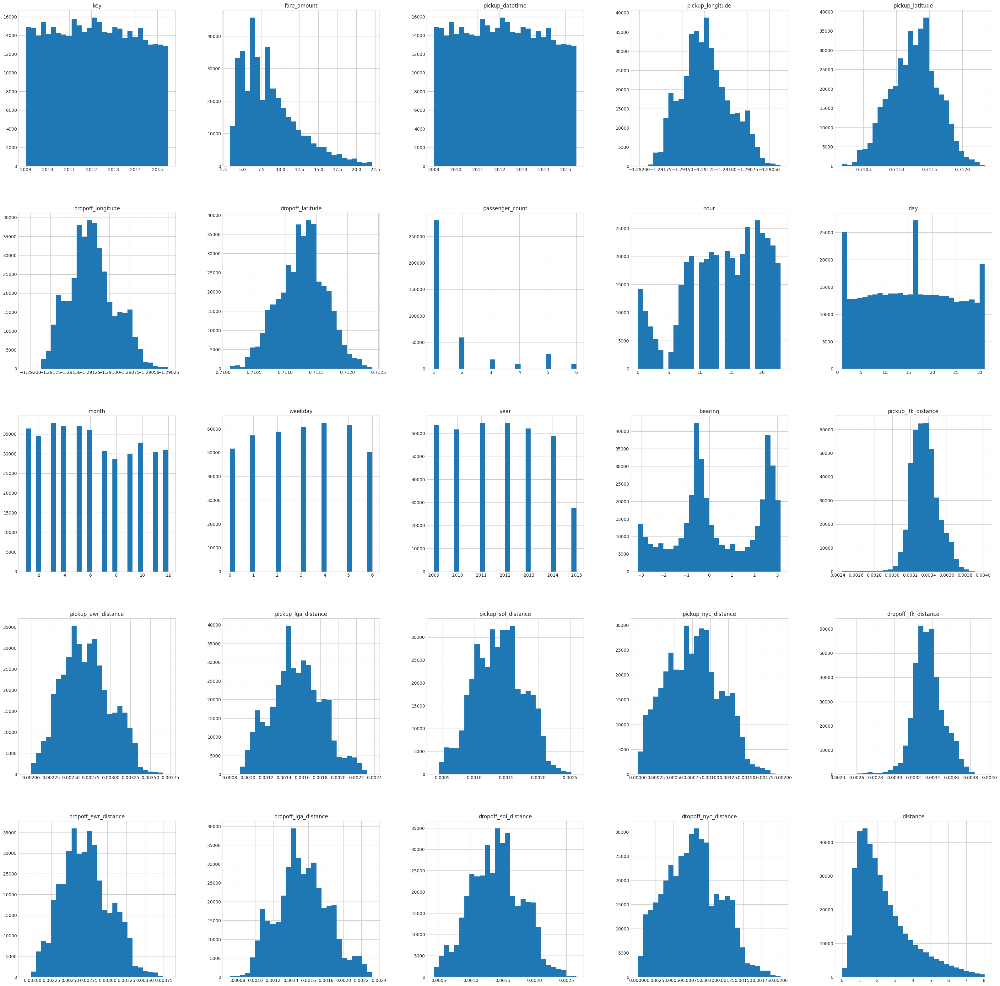

In [68]:
df4.hist(figsize=(40,40), bins=28);

<Axes: xlabel='fare_amount', ylabel='Count'>

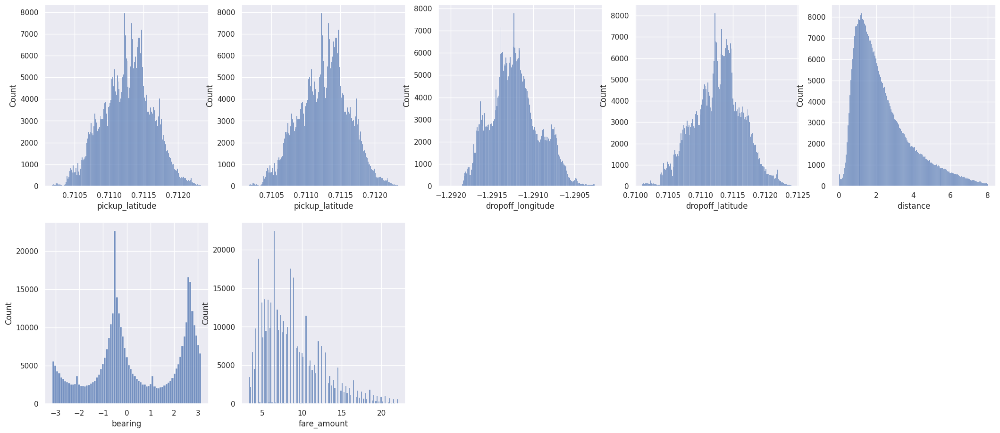

In [69]:
plt.figure(figsize = (26,17))
sns.set(color_codes = True)

plt.subplot(3,5,1)
sns.histplot(df4['pickup_latitude'], kde = False)

plt.subplot(3,5,2)
sns.histplot(df4['pickup_latitude'], kde = False)

plt.subplot(3,5,3)
sns.histplot(df4['dropoff_longitude'], kde = False)

plt.subplot(3,5,4)
sns.histplot(df4['dropoff_latitude'], kde = False)

plt.subplot(3,5,5)
sns.histplot(df4['distance'], kde = False)

plt.subplot(3,5,6)
sns.histplot(df4['bearing'], kde = False)

plt.subplot(3,5,7)
sns.histplot(df4['fare_amount'], kde = False)

**Categorical Variables**

> * **count values in columns**

<Axes: title={'center': 'Variable weekday'}, xlabel='weekday', ylabel='count'>

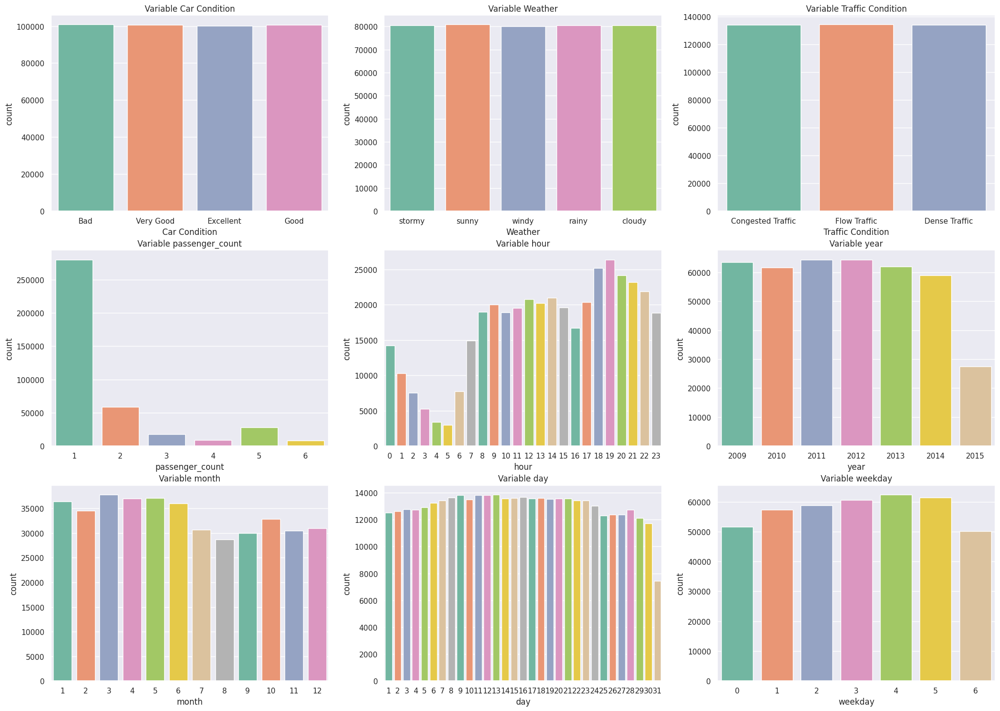

In [70]:
plt.figure(figsize = (25,24))

plt.subplot(4,3,1)
plt.gca().set_title('Variable Car Condition')
sns.countplot(x ='Car Condition', palette = 'Set2', data = df4)

plt.subplot(4,3,2)
plt.gca().set_title('Variable Weather')
sns.countplot(x = 'Weather', palette = 'Set2', data = df4)

plt.subplot(4,3,3)
plt.gca().set_title('Variable Traffic Condition')
sns.countplot(x = 'Traffic Condition', palette = 'Set2', data = df4)

plt.subplot(4,3,4)
plt.gca().set_title('Variable passenger_count')
sns.countplot(x = 'passenger_count', palette = 'Set2', data = df4)

plt.subplot(4,3,5)
plt.gca().set_title('Variable hour')
sns.countplot(x = 'hour', palette = 'Set2', data = df4)

plt.subplot(4,3,6)
plt.gca().set_title('Variable year')
sns.countplot(x = 'year', palette = 'Set2', data = df4)

plt.subplot(4,3,7)
plt.gca().set_title('Variable month')
sns.countplot(x = 'month', palette = 'Set2', data = df4)

plt.subplot(4,3,8)
plt.gca().set_title('Variable day')
sns.countplot(x = 'day', palette = 'Set2', data = df4)

plt.subplot(4,3,9)
plt.gca().set_title('Variable weekday')
sns.countplot(x = 'weekday', palette = 'Set2', data = df4)


<Axes: title={'center': 'Variable weekday'}, xlabel='weekday', ylabel='fare_amount'>

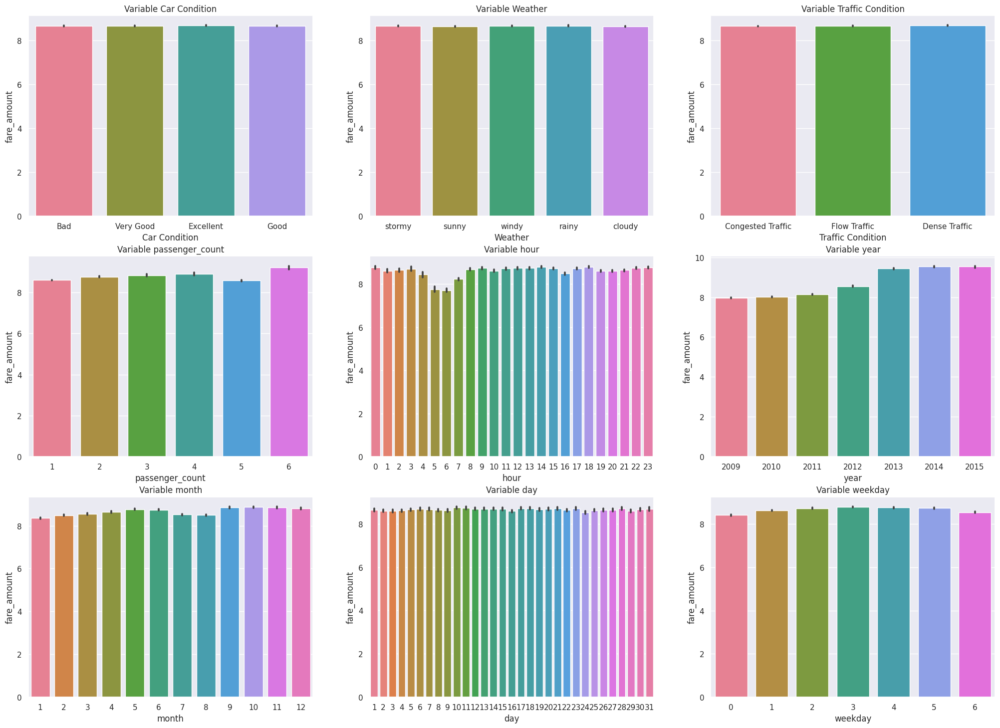

In [71]:
plt.figure(figsize = (25,24))

plt.subplot(4,3,1)
plt.gca().set_title('Variable Car Condition')
sns.barplot(x ='Car Condition',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,2)
plt.gca().set_title('Variable Weather')
sns.barplot(x = 'Weather',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,3)
plt.gca().set_title('Variable Traffic Condition')
sns.barplot(x = 'Traffic Condition',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,4)
plt.gca().set_title('Variable passenger_count')
sns.barplot(x = 'passenger_count',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,5)
plt.gca().set_title('Variable hour')
sns.barplot(x = 'hour',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,6)
plt.gca().set_title('Variable year')
sns.barplot(x = 'year',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,7)
plt.gca().set_title('Variable month')
sns.barplot(x = 'month',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,8)
plt.gca().set_title('Variable day')
sns.barplot(x = 'day',y='fare_amount', palette = 'husl', data = df4)

plt.subplot(4,3,9)
plt.gca().set_title('Variable weekday')
sns.barplot(x = 'weekday',y='fare_amount', palette = 'husl', data = df4)

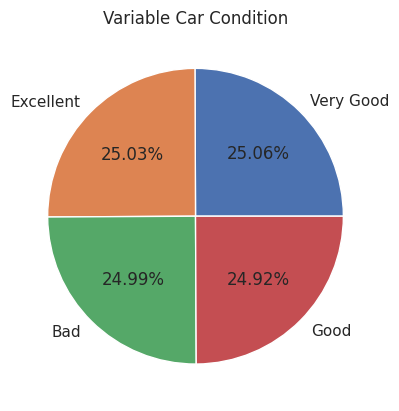

In [72]:
plt.gca().set_title('Variable Car Condition')
label= ['Very Good','Excellent','Bad','Good']
plt.pie(df4["Car Condition"].value_counts(), labels = label,autopct = '%2.2f%%')
plt.show()

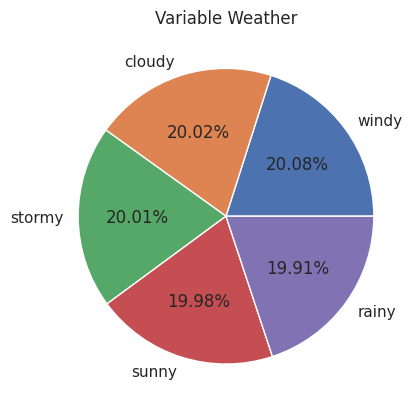

In [73]:
plt.gca().set_title('Variable Weather')
label= [ "windy","cloudy","stormy",'sunny', 'rainy',]
plt.pie(df4["Weather"].value_counts(), labels = label,autopct = '%2.2f%%')
plt.show()

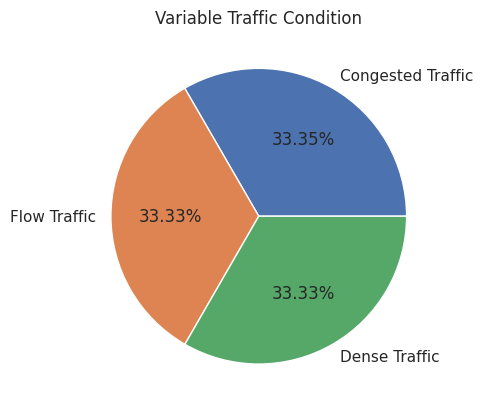

In [74]:
plt.gca().set_title('Variable Traffic Condition')
label= ['Congested Traffic', 'Flow Traffic', 'Dense Traffic']
plt.pie(df4["Traffic Condition"].value_counts(), labels = label,autopct = '%2.2f%%')
plt.show()

**Continous Variables**

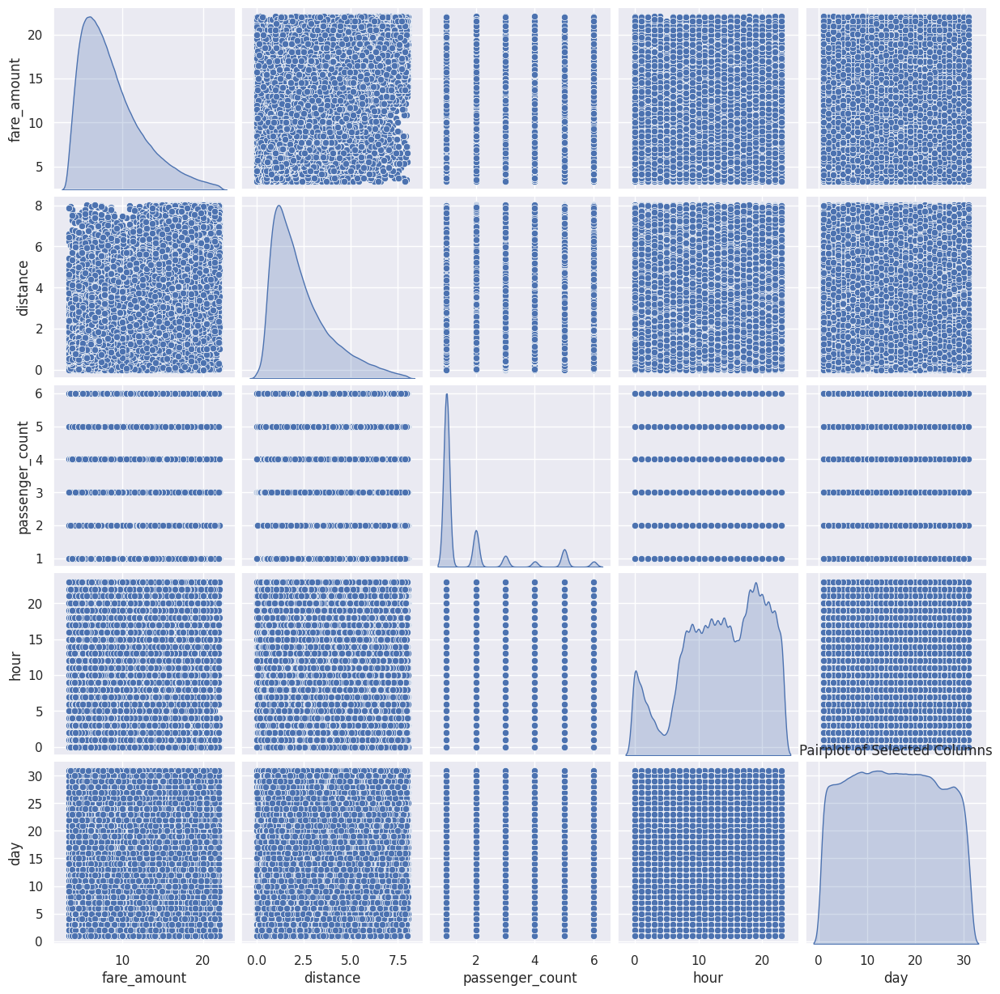

In [75]:
sns.pairplot(df4[['fare_amount', 'distance', 'passenger_count', 'hour', 'day']], diag_kind='kde')
plt.title("Pairplot of Selected Columns")
plt.show()

* **Outliers Visualization**

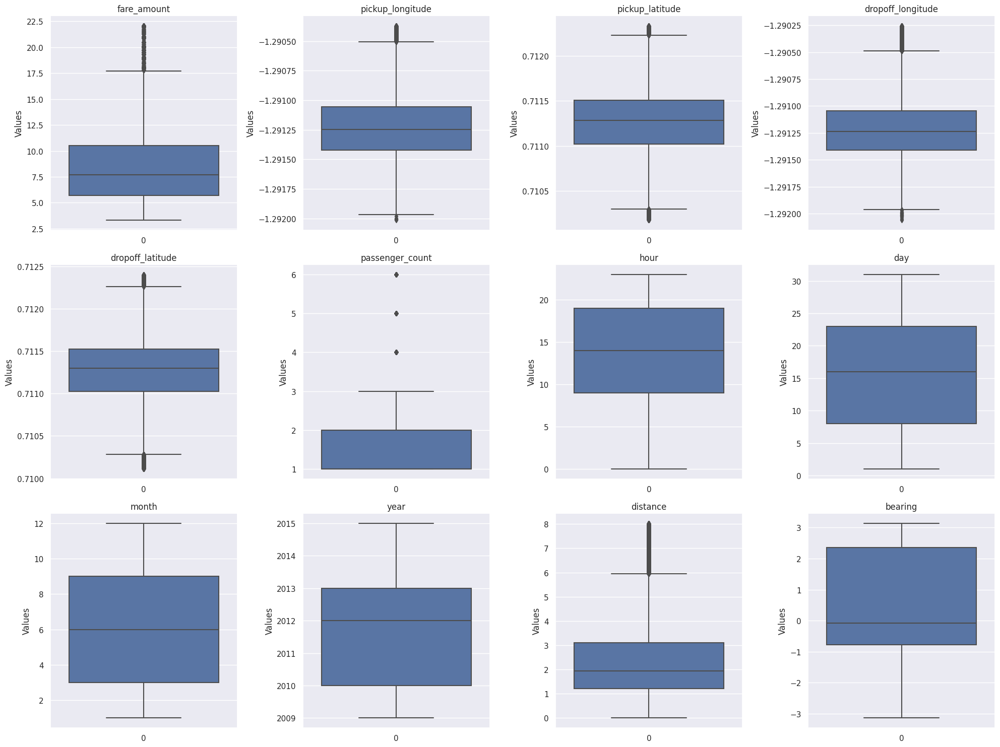

In [76]:
# Define the columns to plot
columns = [ 'fare_amount',
           'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count',
           'hour', 'day', 'month', 'year',
           'distance', 'bearing']

# Set up the subplot grid
num_rows = 3  # Number of rows in the grid
num_cols = 4  # Number of columns in the grid

# Create the figure and axes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 15))
axes = axes.flatten()  # Flatten the axes array for easy indexing

# Plot each column in a separate subplot
for i, column in enumerate(columns):
    ax = axes[i]  # Select the current subplot
    sns.boxplot(df4[column], ax=ax)
    ax.set_title(column)  # Set the title of the subplot
    ax.set_xlabel('')  # Remove the x-axis label for better readability
    ax.set_ylabel('Values')  # Set the y-axis label

# Remove any extra subplots if the number of columns is not a multiple of the grid size
if len(columns) < num_rows * num_cols:
    for j in range(len(columns), num_rows * num_cols):
        fig.delaxes(axes[j])

# Adjust the spacing between subplots
fig.tight_layout()

# Show the plot
plt.show()

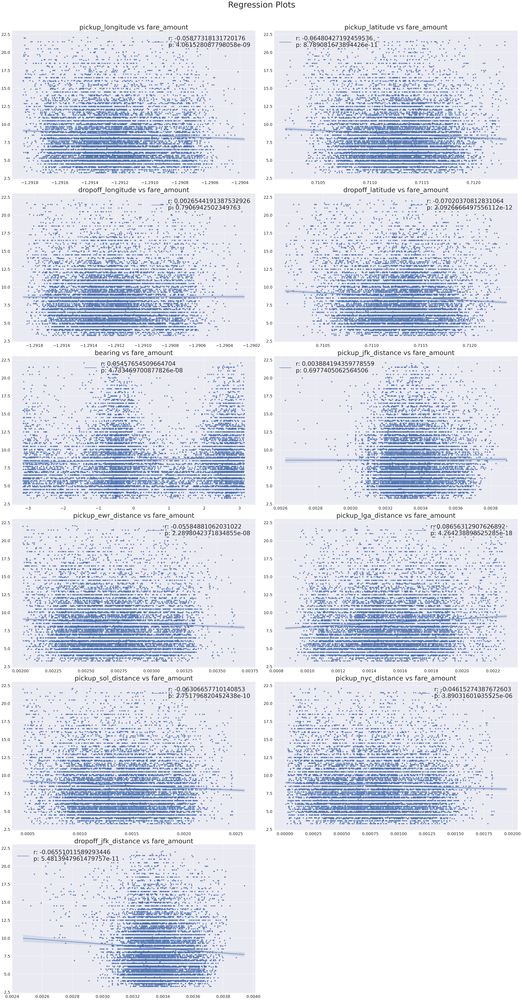

In [77]:
from scipy import stats
# Plot subplots of regression plots
continuous_var = df4.iloc[0:10000, :].select_dtypes(include = ['float32', 'float64']).drop('fare_amount', axis = 1)
fig, axes = plt.subplots(6,2, figsize = (40,80))
for ax, column in zip(axes.flatten(), continuous_var.columns):
    x = continuous_var[column]
    y = df4.fare_amount.iloc[0:10000]
    slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
    sns.regplot(x = continuous_var[column], y = y, ax = ax, line_kws={'label':'r: {}\np: {}'.format(r_value,p_value)})
    ax.set_title('{} vs fare_amount'.format(column), fontsize = 36)
    fig.suptitle('Regression Plots', fontsize = 45)
    ax.tick_params(axis = 'both', which = 'major', labelsize = 22)
    ax.tick_params(axis = 'both', which = 'minor', labelsize = 22)
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.legend(loc = 'best', fontsize = 32)
fig.delaxes(ax = axes[5,1])
fig.tight_layout(rect = [0, 0.03, 1, 0.97])

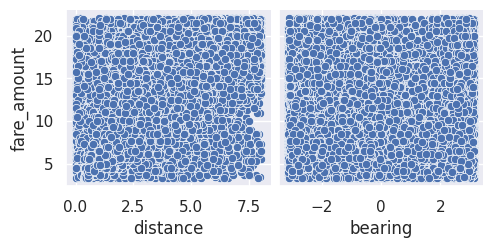

In [78]:
sns.pairplot(df4,
             x_vars=['distance','bearing'],
             y_vars=['fare_amount'])

**Plot Heatmap of Pickups and Dropoffs within NYC**

(-1.292067, -1.28718)

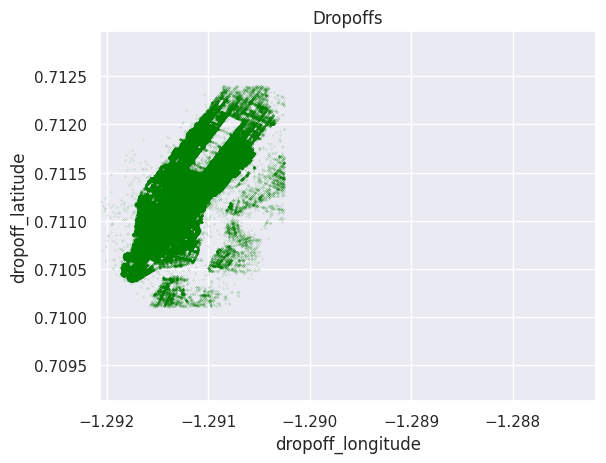

In [79]:
city_long_border = (-1.292067, -1.28718 )
city_lat_border = ( 0.709127,  0.712967 )

df4.plot(kind='scatter', x='dropoff_longitude', y='dropoff_latitude',
                color='green',
                s=.02, alpha=.6)
plt.title("Dropoffs")

plt.ylim(city_lat_border)
plt.xlim(city_long_border)

(-1.292067, -1.28718)

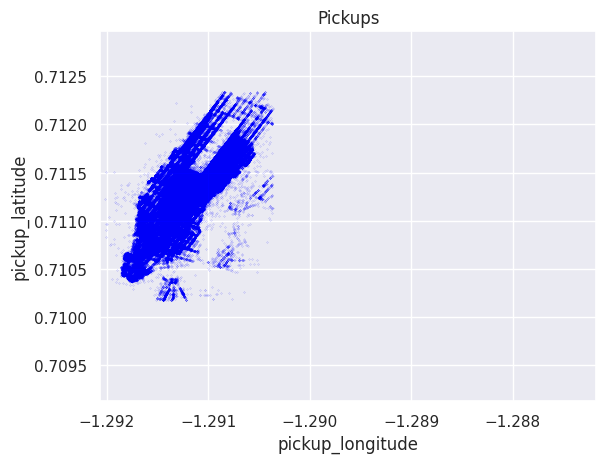

In [80]:
df4.plot(kind='scatter', x='pickup_longitude', y='pickup_latitude',
                color='blue',
                s=.02, alpha=.6)
plt.title("Pickups")

plt.ylim(city_lat_border)
plt.xlim(city_long_border)

In [81]:
# Let's group mean fare_amount by pickup_year to see if there is a pattern.
pivot_year = pd.pivot_table(df4, values = 'fare_amount', index = 'year', aggfunc = ['mean'])
print('Mean fare_amount across the classes of pickup_year: \n{}'.format(pivot_year))

Mean fare_amount across the classes of pickup_year: 
            mean
     fare_amount
year            
2009    7.962361
2010    8.016444
2011    8.135983
2012    8.551428
2013    9.431999
2014    9.535954
2015    9.529407


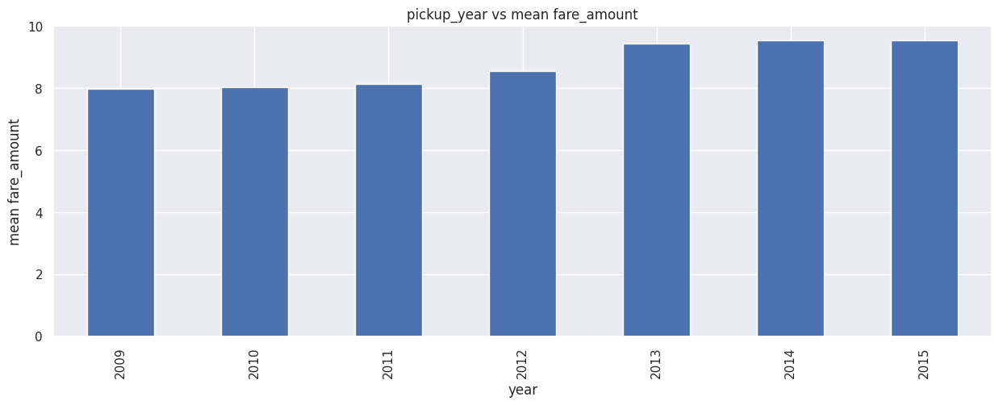

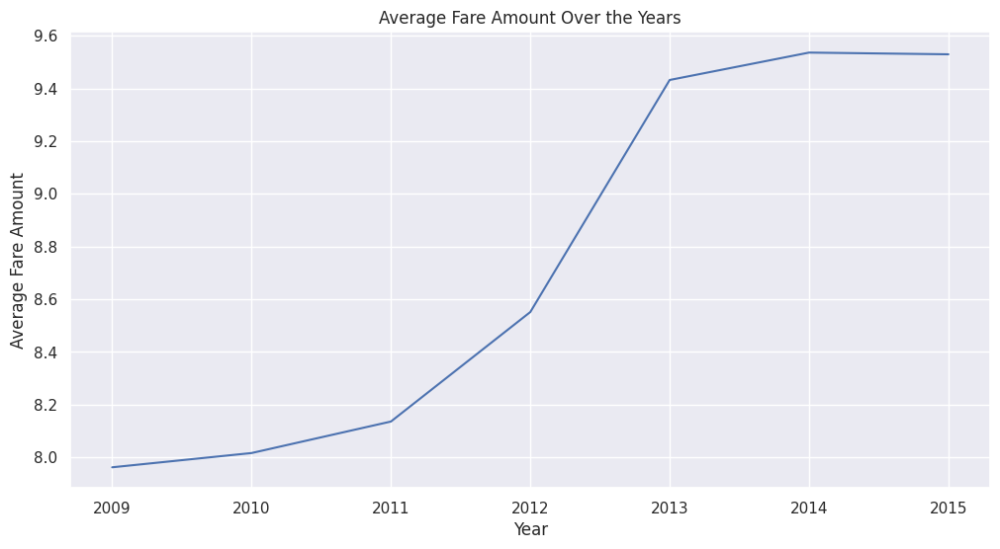

In [82]:
fig, ax = plt.subplots(figsize = (15,5))
pivot_year.plot(kind = 'bar', legend = False, ax = ax)
ax.set(title = 'pickup_year vs mean fare_amount', ylabel= 'mean fare_amount')
plt.show()

plt.figure(figsize=(12, 6))
sns.lineplot(x='year', y='fare_amount', data=df4, estimator='mean', ci=None)
plt.title("Average Fare Amount Over the Years")
plt.xlabel("Year")
plt.ylabel("Average Fare Amount")
plt.show()

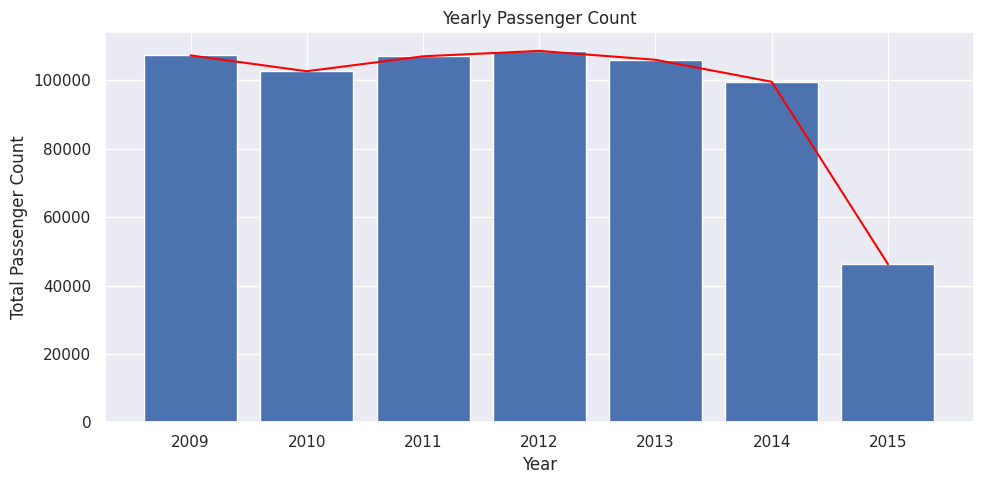

In [83]:
yearly_count = df4.groupby('year')['passenger_count'].sum()
plt.figure(figsize=(10, 5))
plt.bar(yearly_count.index, yearly_count.values, label='Bar Plot')
plt.plot(yearly_count.index, yearly_count.values, linestyle='-' , color='red')
plt.xlabel('Year')
plt.ylabel('Total Passenger Count')
plt.title('Yearly Passenger Count')
plt.grid(True)
plt.tight_layout()
plt.show()

In [84]:
# sns.jointplot(data=df4, x='abs_lat_diff', y='abs_lon_diff',
#              alpha=0.75)

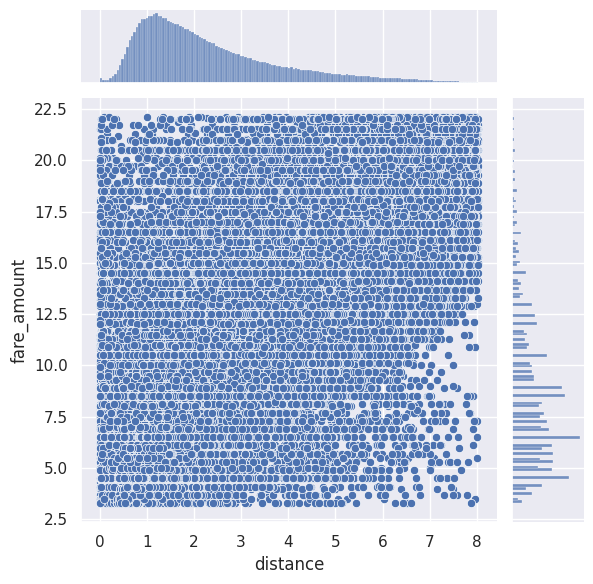

In [85]:
sns.jointplot(x='distance', y='fare_amount', data=df4)

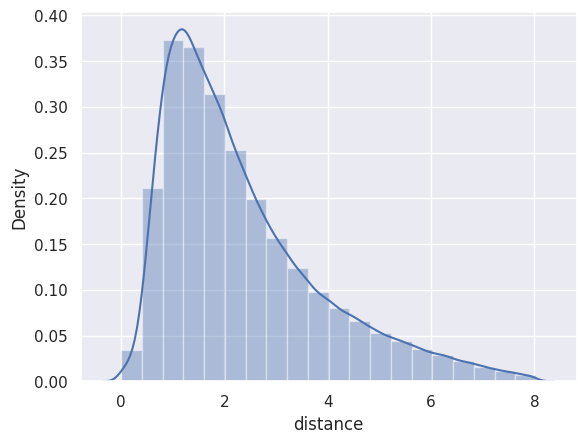

In [86]:
import seaborn as sb
sb.distplot(df4['distance'], bins=20)
plt.show()

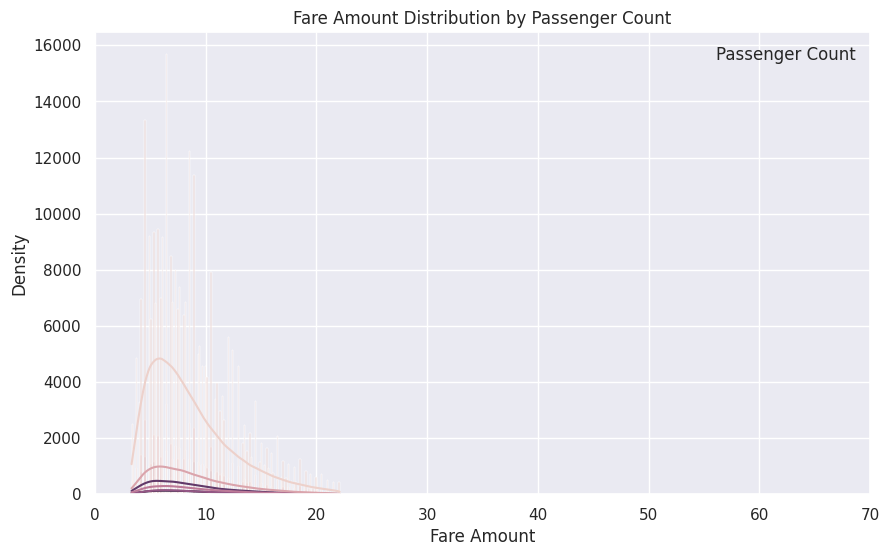

In [87]:
plt.figure(figsize=(10, 6))
sns.histplot(data=df4, x='fare_amount', hue='passenger_count', kde=True)
plt.title("Fare Amount Distribution by Passenger Count")
plt.xlabel("Fare Amount")
plt.ylabel("Density")
plt.legend(title="Passenger Count")
plt.xlim(0, 70)
plt.show()

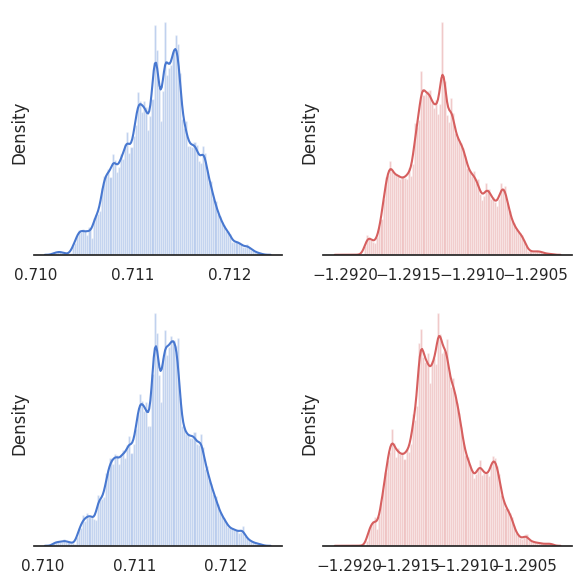

In [88]:
df_data_new = df4.copy()
sb.set(style="white", palette="muted", color_codes=True)
f, axes = plt.subplots(2,2,figsize=(6, 6), sharex=False, sharey = False)#
sb.despine(left=True)
sb.distplot(df_data_new['pickup_latitude'].values, label = 'pickup_latitude',color="b",bins = 100, ax=axes[0,0])
sb.distplot(df_data_new['pickup_longitude'].values, label = 'pickup_longitude',color="r",bins =100, ax=axes[0,1])
sb.distplot(df_data_new['dropoff_latitude'].values, label = 'dropoff_latitude',color="b",bins =100, ax=axes[1, 0])
sb.distplot(df_data_new['dropoff_longitude'].values, label = 'dropoff_longitude',color="r",bins =100, ax=axes[1, 1])
plt.setp(axes, yticks=[])
plt.tight_layout()
plt.show()

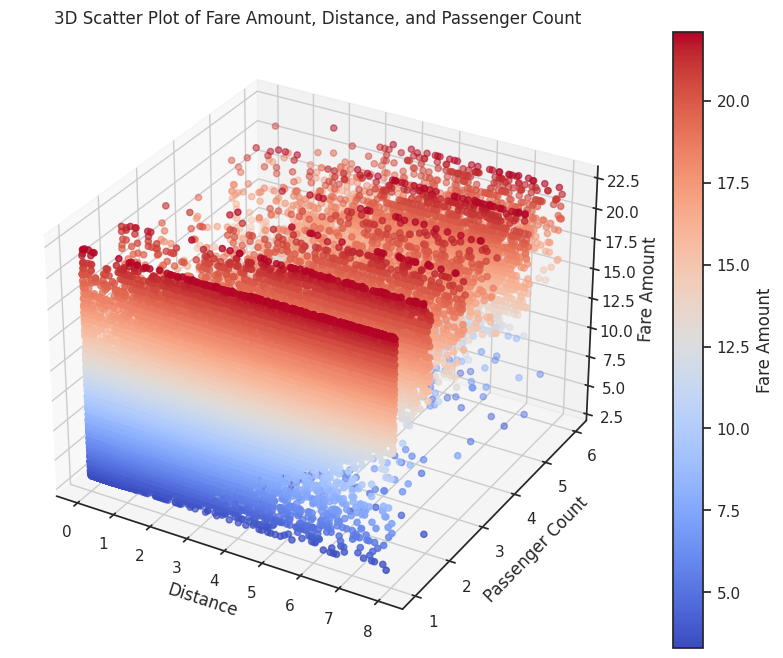

In [89]:
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
fare_amount = df4['fare_amount']
distance = df4['distance']
passenger_count = df4['passenger_count']
scatter = ax.scatter(distance, passenger_count, fare_amount, c=fare_amount, cmap='coolwarm', marker='o')
ax.set_xlabel('Distance')
ax.set_ylabel('Passenger Count')
ax.set_zlabel('Fare Amount')
cbar = plt.colorbar(scatter, ax=ax, label='Fare Amount')
plt.title("3D Scatter Plot of Fare Amount, Distance, and Passenger Count")
plt.show()

# Label Encoding

In [90]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
data['Car Condition']= label_encoder.fit_transform(data['Car Condition'])
label_encoder = preprocessing.LabelEncoder()
data['Weather']= label_encoder.fit_transform(data['Weather'])
label_encoder = preprocessing.LabelEncoder()
data['Traffic Condition']= label_encoder.fit_transform(data['Traffic Condition'])

# Feature Engineering

# Feature Selection

In [91]:
data.drop(['key', 'pickup_datetime','User ID','User Name','Driver Name'], axis = 1, inplace = True)

> * **Plot Correlation Coefficient**

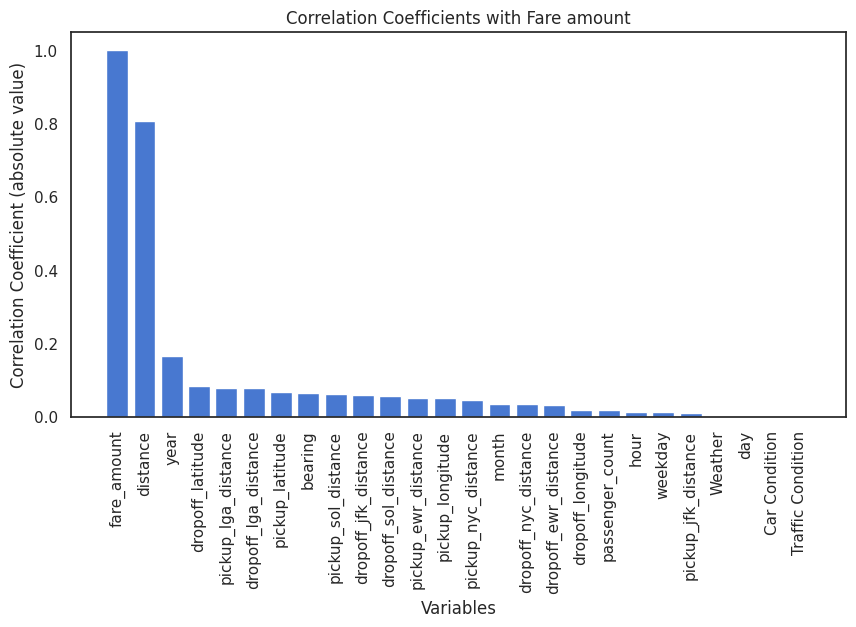

In [92]:
cor = data.corr()
target = abs(cor['fare_amount'])

# Sort the correlation coefficients in descending order
sorted_target = target.sort_values(ascending=False)

# Plot bar graph
plt.figure(figsize=(10, 5))
plt.bar(sorted_target.index, sorted_target.values)
plt.xticks(rotation=90)
plt.xlabel('Variables')
plt.ylabel('Correlation Coefficient (absolute value)')
plt.title('Correlation Coefficients with Fare amount')
plt.savefig('correlation.png')
plt.show()

In [93]:
data[data.columns[1:]].corr()['fare_amount'][:]

Weather                 0.001106
Traffic Condition       0.000334
fare_amount             1.000000
pickup_longitude       -0.050959
pickup_latitude        -0.066424
dropoff_longitude      -0.018734
dropoff_latitude       -0.082402
passenger_count         0.017601
hour                    0.013595
day                     0.000845
month                   0.034043
weekday                 0.012132
year                    0.165226
bearing                 0.064685
pickup_jfk_distance    -0.009928
pickup_ewr_distance    -0.052004
pickup_lga_distance     0.079156
pickup_sol_distance    -0.061026
pickup_nyc_distance    -0.045921
dropoff_jfk_distance   -0.058742
dropoff_ewr_distance   -0.032777
dropoff_lga_distance    0.077046
dropoff_sol_distance   -0.055624
dropoff_nyc_distance   -0.034037
distance                0.806915
Name: fare_amount, dtype: float64

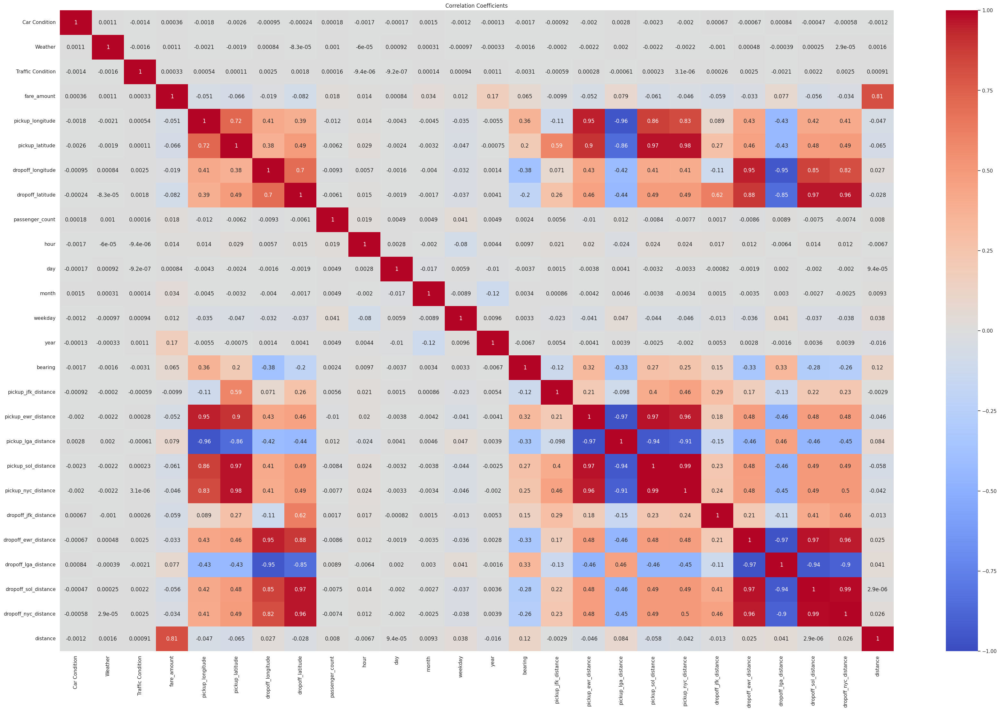

In [94]:
#plot heatmap
plt.subplots(figsize=(42, 26))
sns.heatmap(cor, cmap='coolwarm', annot=True, vmin=-1, vmax=1, center=0)
plt.title('Correlation Coefficients')
plt.savefig('heatmap.png')
plt.show()

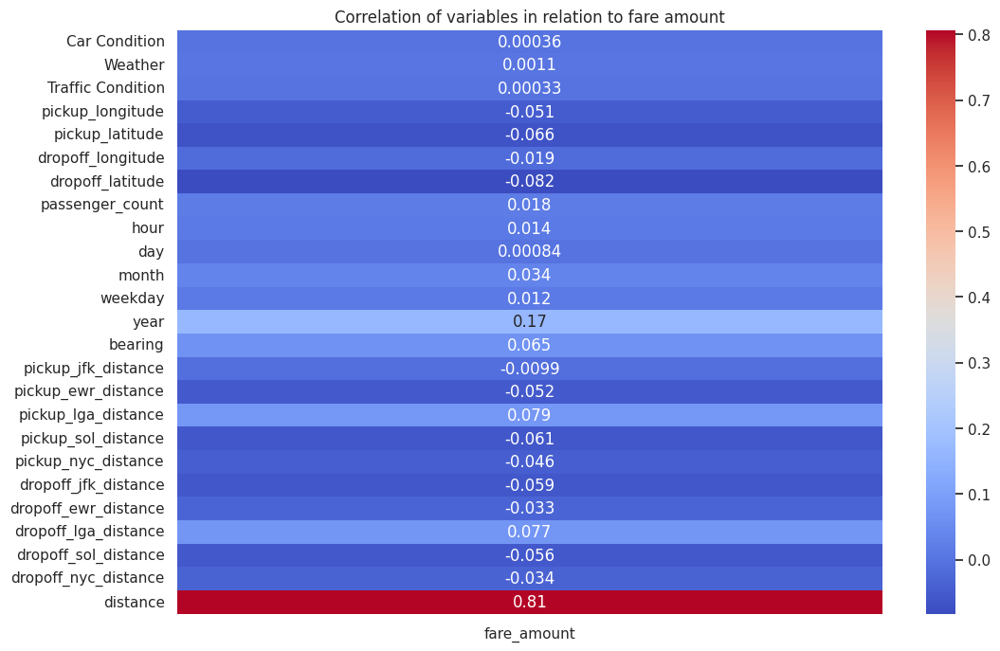

In [95]:
corr_matrix = data.corr()["fare_amount"]
corr_matrix = corr_matrix.drop("fare_amount", axis=0)
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix.to_frame(), cmap="coolwarm", annot=True)
plt.title("Correlation of variables in relation to fare amount")
plt.show()

In [96]:
data.shape

(402345, 26)

<div class="alert alert-block alert-success">  
 Best Feature Selection approache
</div>

In [97]:
df5=data.copy()

In [98]:
cor = df5.corr()
target = abs(cor['fare_amount'])
features = list(target[target >= 0.01].index)
for c in df5.columns:
    if c != 'fare_amount' and c not in features:
        df5.drop(columns=c, axis=1, inplace=True)

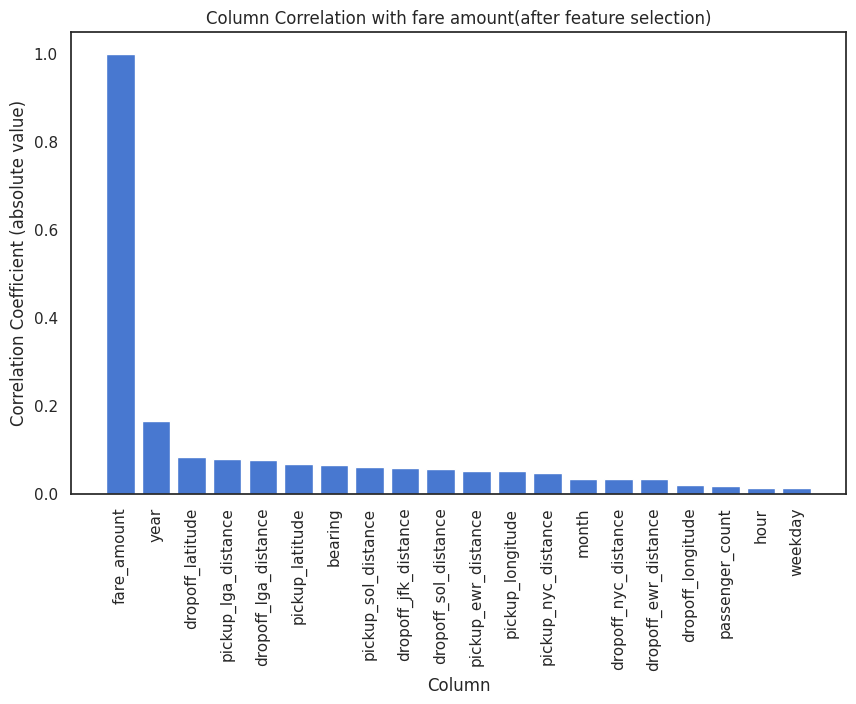

In [99]:
correlations = []
for column in features[:-1]:
    correlation = np.abs(df5[column].corr(df5['fare_amount']))
    correlations.append(correlation)

sorted_features = [x for _, x in sorted(zip(correlations, features[:-1]), reverse=True)]
sorted_correlations = np.sort(correlations)[::-1]

plt.figure(figsize=(10, 6))
plt.bar(sorted_features, sorted_correlations)
plt.xlabel('Column')
plt.ylabel('Correlation Coefficient (absolute value)')
plt.title('Column Correlation with fare amount(after feature selection)')
plt.xticks(rotation=90)
plt.show()

In [100]:
df5.shape

(402345, 21)

In [101]:
df5.isnull().sum().sort_values(ascending=False)

fare_amount             0
pickup_ewr_distance     0
dropoff_nyc_distance    0
dropoff_sol_distance    0
dropoff_lga_distance    0
dropoff_ewr_distance    0
dropoff_jfk_distance    0
pickup_nyc_distance     0
pickup_sol_distance     0
pickup_lga_distance     0
bearing                 0
pickup_longitude        0
year                    0
weekday                 0
month                   0
hour                    0
passenger_count         0
dropoff_latitude        0
dropoff_longitude       0
pickup_latitude         0
distance                0
dtype: int64

> * **Train Test Split**

In [102]:
from sklearn.model_selection import train_test_split
X = df5.drop(columns=['fare_amount'])
y = df5['fare_amount']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10, random_state=42)

In [103]:
# # Applying PCA function on training
# # and testing set of X component
# from sklearn.decomposition import PCA

# pca = PCA(n_components = 2)

# X_train = pca.fit_transform(X_train)
# X_test = pca.transform(X_test)

# explained_variance = pca.explained_variance_ratio_

In [104]:
# Compute mutual information scores
from sklearn.feature_selection import SelectKBest, mutual_info_regression

mi_selector = SelectKBest(score_func=mutual_info_regression, k='all')
mi_selector.fit(X_train, y_train)

mi_scores = mi_selector.scores_
feature_names= X_train.columns

# Sort the features by their MI scores
sorted_features = sorted(zip(feature_names, mi_scores), key=lambda x: x[1], reverse=True)
print("\nMI Scores:")
for feature, score in sorted_features:
    print(feature, ':', score)


MI Scores:
distance : 0.6684956818789676
year : 0.45384389841066586
bearing : 0.03980934665999847
dropoff_latitude : 0.031821002499375695
dropoff_sol_distance : 0.024752026910130454
dropoff_jfk_distance : 0.023000270287120372
dropoff_lga_distance : 0.02294763006183409
pickup_latitude : 0.020055913536241476
dropoff_nyc_distance : 0.018297723813425648
dropoff_ewr_distance : 0.01823506870399072
dropoff_longitude : 0.017031467421420032
pickup_lga_distance : 0.016764414136876127
pickup_ewr_distance : 0.01583548499966625
pickup_sol_distance : 0.015805265379071898
month : 0.015654259643916646
pickup_longitude : 0.014534028771407748
pickup_nyc_distance : 0.013434056647977144
hour : 0.009769636076884858
passenger_count : 0.005787011144339438
weekday : 0.0014316603378610182


In [105]:
# k = 22
# top_features_indices = (-mi_scores).argsort()[:k]
# top_features = [feature_names[i] for i in top_features_indices]

# X_train = X_train[top_features]
# X_test = X_test[top_features]

# Feature Scaling

In [106]:
# from sklearn.preprocessing import QuantileTransformer

# scaler = QuantileTransformer(output_distribution='normal')

# X_train= scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

In [107]:
from sklearn.preprocessing import MinMaxScaler
X_scaler = MinMaxScaler()

X_scaler.fit(X_train)
X_train = pd.DataFrame(X_scaler.transform(X_train), columns=X_train.columns)
X_test = pd.DataFrame(X_scaler.transform(X_test), columns=X_test.columns)

y_scaler = MinMaxScaler()
y_train = y_train.values.reshape(-1, 1)
y_test = y_test.values.reshape(-1, 1)

y_scaler.fit(y_train)
y_train = y_scaler.transform(y_train)
y_test = y_scaler.transform(y_test)

In [108]:
X_train.head()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,month,weekday,year,bearing,pickup_ewr_distance,pickup_lga_distance,pickup_sol_distance,pickup_nyc_distance,dropoff_jfk_distance,dropoff_ewr_distance,dropoff_lga_distance,dropoff_sol_distance,dropoff_nyc_distance,distance
0,0.580011,0.839818,0.368019,0.602919,0.0,0.565217,0.000000,1.000000,0.666667,0.924954,0.675056,0.348654,0.759547,0.744172,0.747255,0.396561,0.542096,0.485436,0.453679,0.443875
1,0.476298,0.272848,0.490730,0.575847,0.0,0.869565,0.545455,0.000000,0.833333,0.489609,0.331667,0.584473,0.293147,0.183831,0.633796,0.460558,0.445531,0.500535,0.450113,0.528768
2,0.457559,0.476611,0.289037,0.353831,0.0,0.695652,0.363636,0.666667,1.000000,0.899050,0.391992,0.476035,0.424899,0.344048,0.597268,0.225762,0.706602,0.242576,0.166016,0.280719
3,0.603645,0.504596,0.730070,0.791720,0.8,0.391304,0.000000,0.500000,0.333333,0.450396,0.498928,0.354262,0.497917,0.418220,0.703995,0.736922,0.241943,0.767160,0.741543,0.549793
4,0.546150,0.742420,0.417603,0.703685,0.2,0.695652,0.454545,0.666667,0.333333,0.809642,0.591578,0.356630,0.667593,0.635868,0.810695,0.488887,0.491929,0.591777,0.572749,0.122674


# Model Engineering

In [109]:
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
lr = LinearRegression()
lr.fit(X_train, y_train)
lr_pred = lr.predict(X_test)
print('linear Mean Square Error = ', metrics.mean_squared_error(y_test, lr_pred))
print("r2 score = ", r2_score(y_test, lr_pred))
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, lr_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, lr_pred)))

linear Mean Square Error =  0.01215397286557614
r2 score =  0.7018753080794888
Mean Squared Error (MSE): 0.01215397286557614
Root Mean Squared Error (RMSE): 0.11024505823653112


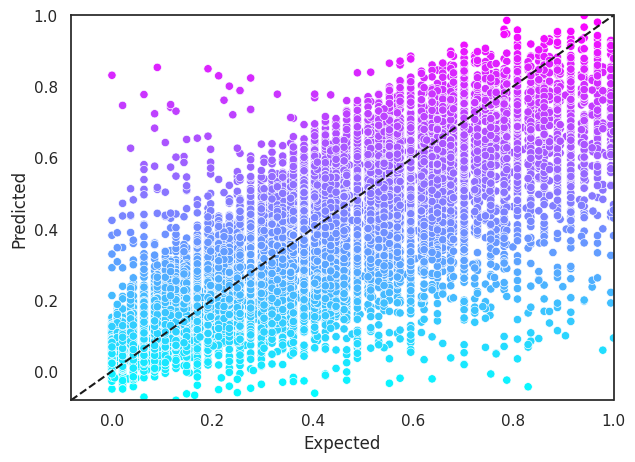

In [110]:
# Assuming y_test and lr_pred are NumPy arrays
y_test_flat = y_test.flatten()
lr_pred_flat = lr_pred.flatten()

data['Expected'] = pd.Series(y_test_flat)
data['Predicted'] = pd.Series(lr_pred_flat)

figure = plt.figure(figsize=(7, 5))

axes = sns.scatterplot(data=data, x='Expected', y='Predicted',
                       hue='Predicted', palette='cool',
                       legend=False)

start = min(y_test_flat.min(), lr_pred_flat.min())
end = max(y_test_flat.max(), lr_pred_flat.max())

axes.set_xlim(start, end)
axes.set_ylim(start, end)

line = plt.plot([start, end], [start, end], 'k--')

plt.show()

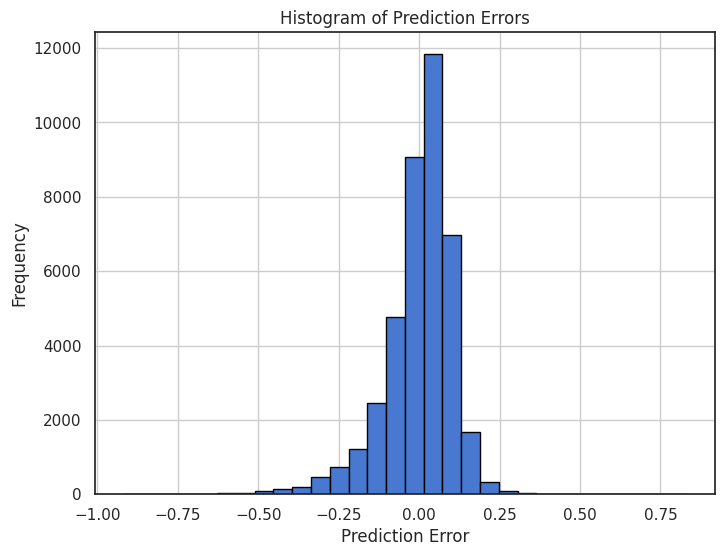

In [111]:
# Calculate prediction errors
errors = lr_pred - y_test

# Plot histogram
plt.figure(figsize=(8, 6))
plt.hist(errors, bins=30, edgecolor='black')
plt.xlabel('Prediction Error')
plt.ylabel('Frequency')
plt.title('Histogram of Prediction Errors')
plt.grid(True)
plt.show()

In [112]:
import lightgbm as lgb
from sklearn.metrics import mean_squared_error
import numpy as np
from math import sqrt

lgb_model = lgb.LGBMRegressor(objective='regression', num_leaves=35, n_estimators=300)

lgb_model.fit(X_train, y_train)
y_LGB_predict = lgb_model.predict(X_test)

print('Mean Squared Error (MSE):', mean_squared_error(y_test, y_LGB_predict))
print("r2 score = ", r2_score(y_test, y_LGB_predict))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, y_LGB_predict)))

Mean Squared Error (MSE): 0.007565780199034146
r2 score =  0.8144190450380409
Root Mean Squared Error (RMSE): 0.08698149342839628


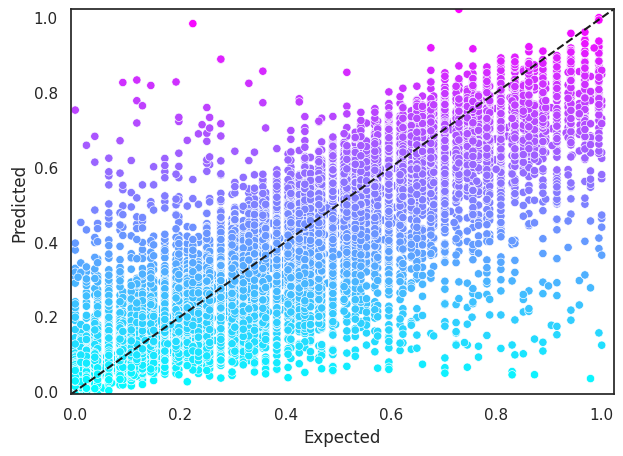

In [113]:
# Assuming y_test and y_LGB_predict are NumPy arrays
y_test_array = y_test.flatten()
y_LGB_predict_array = y_LGB_predict.flatten()

data['Expected'] = pd.Series(y_test_array)
data['Predicted'] = pd.Series(y_LGB_predict_array)

figure = plt.figure(figsize=(7, 5))

axes = sns.scatterplot(data=data, x='Expected', y='Predicted',
                       hue='Predicted', palette='cool',
                       legend=False)

start = min(y_test_array.min(), y_LGB_predict_array.min())
end = max(y_test_array.max(), y_LGB_predict_array.max())

axes.set_xlim(start, end)
axes.set_ylim(start, end)

line = plt.plot([start, end], [start, end], 'k--')

plt.show()

In [114]:
X_train.columns

Index(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour', 'month', 'weekday',
       'year', 'bearing', 'pickup_ewr_distance', 'pickup_lga_distance',
       'pickup_sol_distance', 'pickup_nyc_distance', 'dropoff_jfk_distance',
       'dropoff_ewr_distance', 'dropoff_lga_distance', 'dropoff_sol_distance',
       'dropoff_nyc_distance', 'distance'],
      dtype='object')

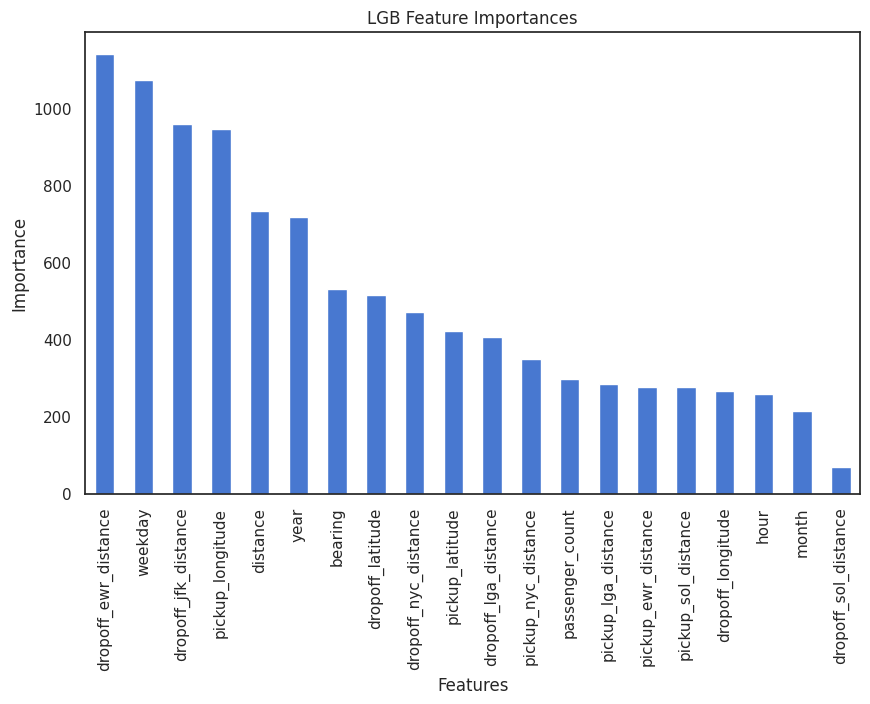

In [115]:
# Asabssuming 'columns' is a list of column names excluding the target variable column
columns = ['distance', 'year', 'bearing', 'dropoff_latitude',
       'dropoff_sol_distance', 'dropoff_jfk_distance', 'dropoff_lga_distance',
       'pickup_latitude', 'dropoff_nyc_distance', 'dropoff_ewr_distance',
       'dropoff_longitude', 'pickup_lga_distance', 'pickup_ewr_distance',
       'pickup_sol_distance', 'pickup_longitude', 'month',
       'pickup_nyc_distance', 'hour', 'passenger_count', 'weekday']

# Create the feature importance Series
feature_imp_random = pd.Series(lgb_model.feature_importances_, index=columns).sort_values(ascending=False)

# Plot the feature importances
plt.figure(figsize=(10, 6))
feature_imp_random.plot(kind='bar')
plt.title('LGB Feature Importances')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.show()

In [116]:
import xgboost as xgb
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42, tree_method='exact')
xgb_model.fit(X_train, y_train)
y_XGB_predict = xgb_model.predict(X_test)
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, y_XGB_predict))
print("r2 score = ", r2_score(y_test, y_XGB_predict))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, y_XGB_predict)))

Mean Squared Error (MSE): 0.007822931712006128
r2 score =  0.8081113778719573
Root Mean Squared Error (RMSE): 0.08844733863721467


In [117]:
xgb_model.save_model('xgb_model.model')

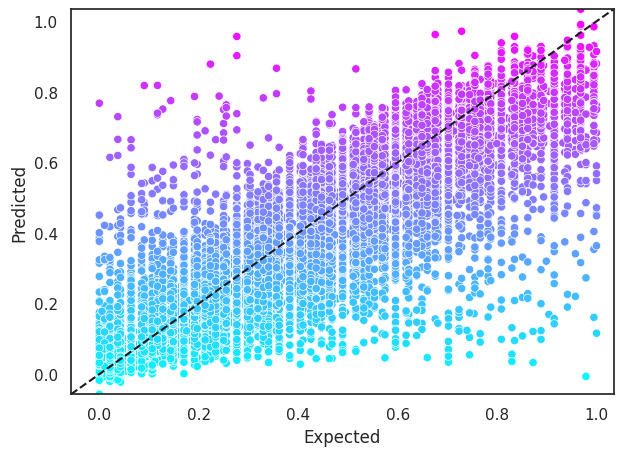

In [118]:
# Assuming y_test and y_XGB_predict are NumPy arrays
y_test_array = y_test.flatten()
y_XGB_predict_array = y_XGB_predict.flatten()

data['Expected'] = pd.Series(y_test_array)
data['Predicted'] = pd.Series(y_XGB_predict_array)

figure = plt.figure(figsize=(7, 5))

axes = sns.scatterplot(data=data, x='Expected', y='Predicted',
                       hue='Predicted', palette='cool',
                       legend=False)

start = min(y_test_array.min(), y_XGB_predict_array.min())
end = max(y_test_array.max(), y_XGB_predict_array.max())

axes.set_xlim(start, end)
axes.set_ylim(start, end)

line = plt.plot([start, end], [start, end], 'k--')

plt.show()

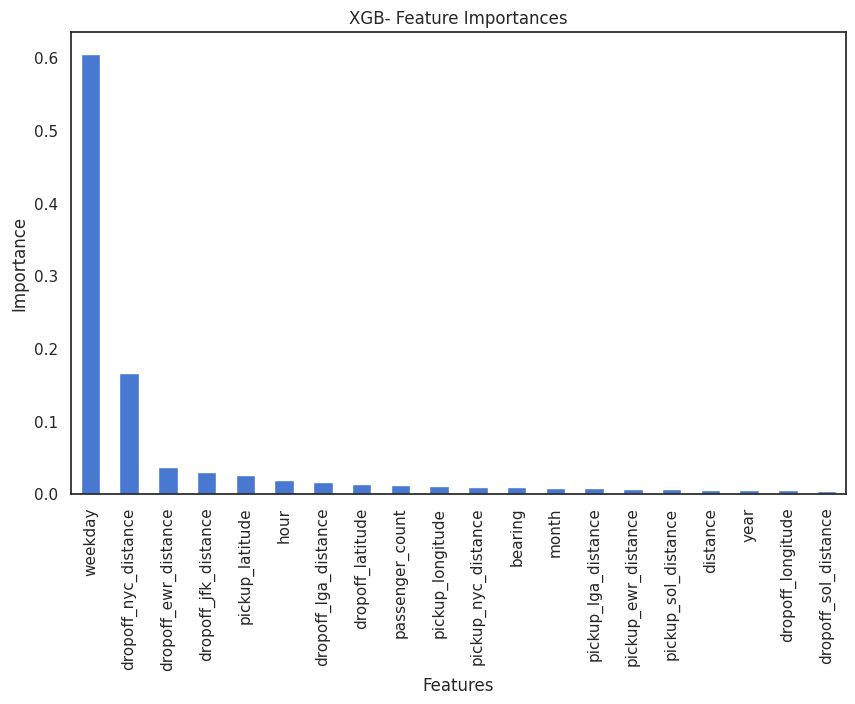

In [119]:
# Create the feature importance Series
feature_imp_random = pd.Series(xgb_model.feature_importances_, index=columns).sort_values(ascending=False)

# Plot the feature importances
plt.figure(figsize=(10, 6))
feature_imp_random.plot(kind='bar')
plt.title('XGB- Feature Importances')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.show()

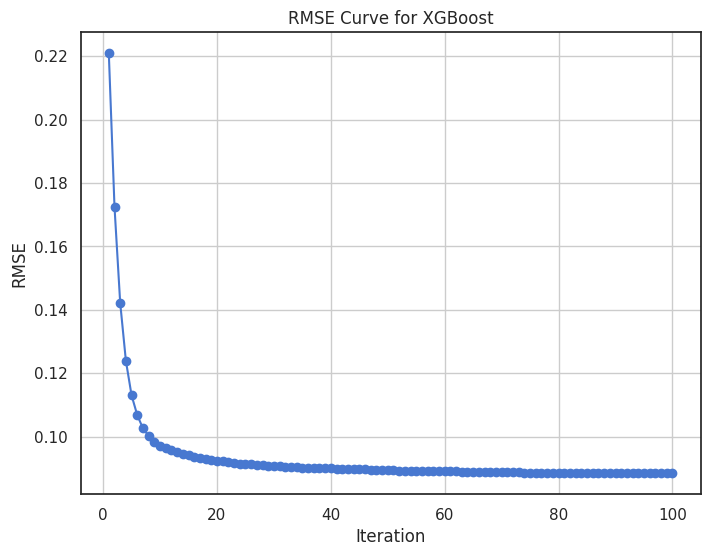

In [120]:
# Training the XGBRegressor model with evaluation set
xgb_model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=False)

# Retrieving the evaluation results
eval_results = xgb_model.evals_result()

# Plotting the RMSE curve
num_iterations = len(eval_results['validation_0']['rmse'])
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_iterations + 1), eval_results['validation_0']['rmse'], marker='o')
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('RMSE Curve for XGBoost')
plt.grid(True)
plt.show()

Train RMSE: 0.08406841492453525
Test RMSE: 0.08844733863721467


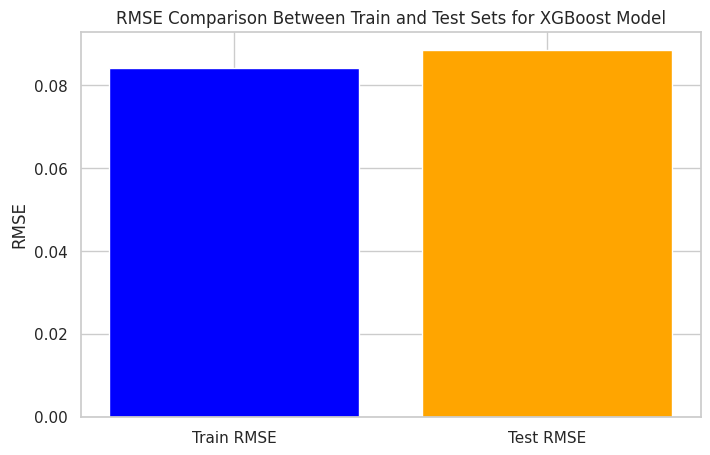

In [121]:
# Assuming you have X_train, y_train, X_test, and y_test
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42, tree_method='exact')
xgb_model.fit(X_train, y_train)

# Make predictions
y_train_pred = xgb_model.predict(X_train)
y_test_pred = xgb_model.predict(X_test)

# Calculate RMSE
train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))

print(f"Train RMSE: {train_rmse}")
print(f"Test RMSE: {test_rmse}")

# Plotting the RMSE values for the training and test sets
plt.figure(figsize=(8, 5))
sns.set(style="whitegrid")

labels = ['Train RMSE', 'Test RMSE']
rmse_values = [train_rmse, test_rmse]

plt.bar(labels, rmse_values, color=['blue', 'orange'])
plt.title('RMSE Comparison Between Train and Test Sets for XGBoost Model')
plt.ylabel('RMSE')
plt.show()

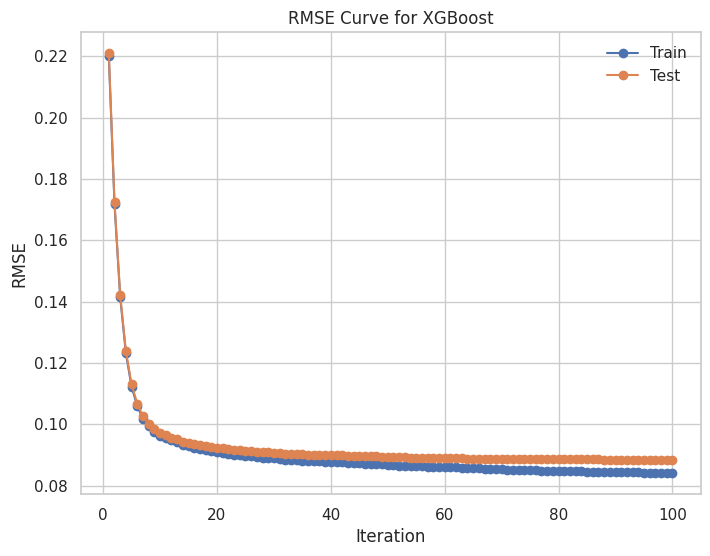

In [122]:
import xgboost as xgb
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split

# Assuming you have X_train, y_train, X_test, y_test
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42, tree_method='exact')

# Training the XGBRegressor model with evaluation set
xgb_model.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_test, y_test)], verbose=False)

# Retrieving the evaluation results
eval_results = xgb_model.evals_result()

# Plotting the RMSE curve for both training and test sets
num_iterations = len(eval_results['validation_0']['rmse'])
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_iterations + 1), eval_results['validation_0']['rmse'], marker='o', label='Train')
plt.plot(range(1, num_iterations + 1), eval_results['validation_1']['rmse'], marker='o', label='Test')
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('RMSE Curve for XGBoost')
plt.legend()
plt.grid(True)
plt.show()


In [123]:
# from sklearn.ensemble import VotingRegressor

# # Create the VotingRegressor without specifying the voting parameter
# voting_model = VotingRegressor([('lgb', lgb_model), ('xgb', xgb_model)])
# voting_model.fit(X_train, y_train)
# voting_predict = voting_model.predict(X_test)

# # Calculate the performance metrics for the voting predictions
# voting_mse = mean_squared_error(y_test, voting_predict)
# voting_r2 = r2_score(y_test, voting_predict)
# voting_rmse = np.sqrt(voting_mse)

# print('Voting Mean Squared Error (MSE):', voting_mse)
# print('Voting R2 Score:', voting_r2)
# print('Voting Root Mean Squared Error (RMSE):', voting_rmse)

In [124]:
from sklearn.ensemble import RandomForestRegressor
regr = RandomForestRegressor( random_state=0)
regr.fit(X_train, y_train)
rf_pred = regr.predict(X_test)
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, rf_pred))
print("r2 score = ", r2_score(y_test, rf_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, rf_pred)))

Mean Squared Error (MSE): 0.008408571277898078
r2 score =  0.7937462301882313
Root Mean Squared Error (RMSE): 0.0916982621312862


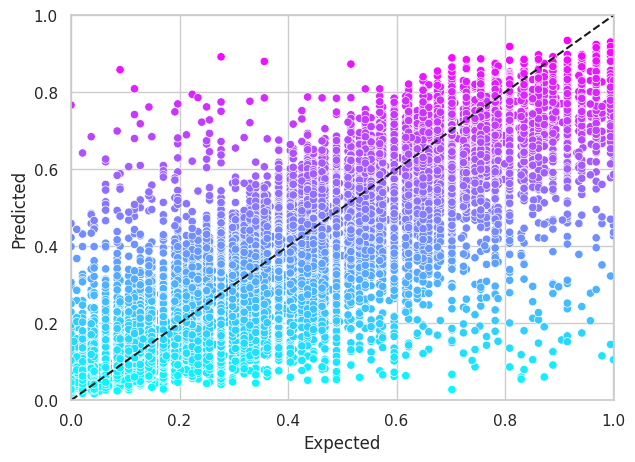

In [125]:
# Assuming y_test and rf_pred are NumPy arrays
y_test_array = y_test.flatten()
rf_pred_array = rf_pred.flatten()

data['Expected'] = pd.Series(y_test_array)
data['Predicted'] = pd.Series(rf_pred_array)

figure = plt.figure(figsize=(7, 5))

axes = sns.scatterplot(data=data, x='Expected', y='Predicted',
                       hue='Predicted', palette='cool',
                       legend=False)

start = min(y_test_array.min(), rf_pred_array.min())
end = max(y_test_array.max(), rf_pred_array.max())

axes.set_xlim(start, end)
axes.set_ylim(start, end)

line = plt.plot([start, end], [start, end], 'k--')

plt.show()

In [126]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error

regr = DecisionTreeRegressor(random_state=0)
regr.fit(X_train, y_train)
dt_pred = regr.predict(X_test)
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, dt_pred))
print("r2 score = ", r2_score(y_test, dt_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, dt_pred)))

Mean Squared Error (MSE): 0.017254285469651673
r2 score =  0.5767697857449003
Root Mean Squared Error (RMSE): 0.13135556885664068


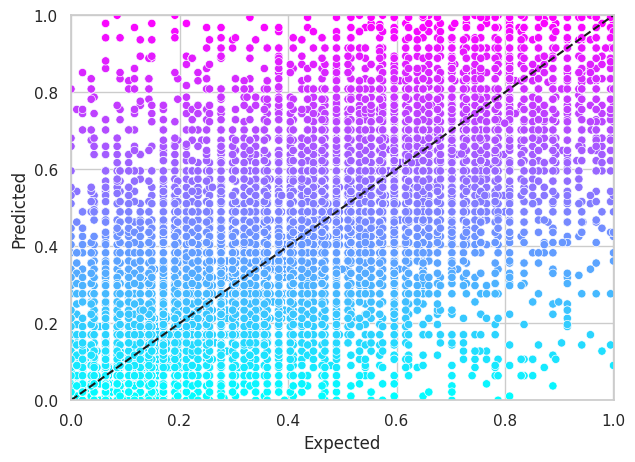

In [127]:
# Assuming y_test and dt_pred are NumPy arrays
y_test_array = y_test.flatten()
dt_pred_array = dt_pred.flatten()

data['Expected'] = pd.Series(y_test_array)
data['Predicted'] = pd.Series(dt_pred_array)

figure = plt.figure(figsize=(7, 5))

axes = sns.scatterplot(data=data, x='Expected', y='Predicted',
                       hue='Predicted', palette='cool',
                       legend=False)

start = min(y_test_array.min(), dt_pred_array.min())
end = max(y_test_array.max(), dt_pred_array.max())

axes.set_xlim(start, end)
axes.set_ylim(start, end)

line = plt.plot([start, end], [start, end], 'k--')

plt.show()

In [128]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Create polynomial features (e.g., quadratic features)
degree = 2  # You can adjust the degree as needed
poly_features = PolynomialFeatures(degree=degree, include_bias=False)
X_poly = poly_features.fit_transform(X_train)  # X_train is your feature matrix

# Fit a linear regression model to the polynomial features
poly_model = LinearRegression()
poly_model.fit(X_poly, y_train)  # y_train is your target variable

# Transform the test data using the same polynomial features
X_poly_test = poly_features.transform(X_test)

# Make predictions on the test set
poly_pred = poly_model.predict(X_poly_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, poly_pred)
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, poly_pred))
print("r2 score = ", r2_score(y_test, poly_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, poly_pred)))

Mean Squared Error (MSE): 0.009944467287225388
r2 score =  0.7560722506864727
Root Mean Squared Error (RMSE): 0.0997219498767718


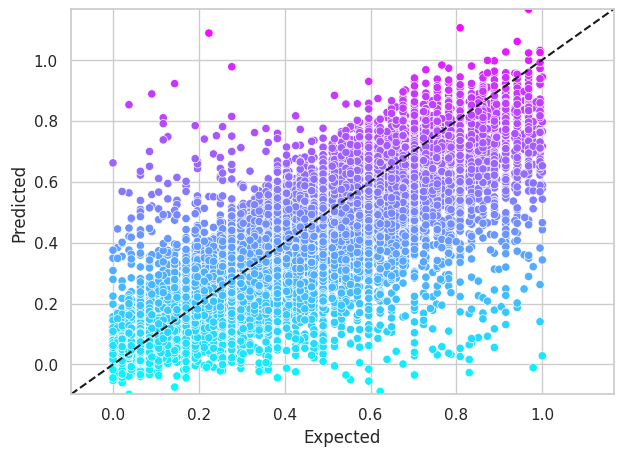

In [129]:
# Assuming y_test and poly_pred are NumPy arrays
y_test_array = y_test.flatten()
poly_pred_array = poly_pred.flatten()

data['Expected'] = pd.Series(y_test_array)
data['Predicted'] = pd.Series(poly_pred_array)

figure = plt.figure(figsize=(7, 5))

axes = sns.scatterplot(data=data, x='Expected', y='Predicted',
                       hue='Predicted', palette='cool',
                       legend=False)

start = min(y_test_array.min(), poly_pred_array.min())
end = max(y_test_array.max(), poly_pred_array.max())

axes.set_xlim(start, end)
axes.set_ylim(start, end)

line = plt.plot([start, end], [start, end], 'k--')

plt.show()

# Model Comparison

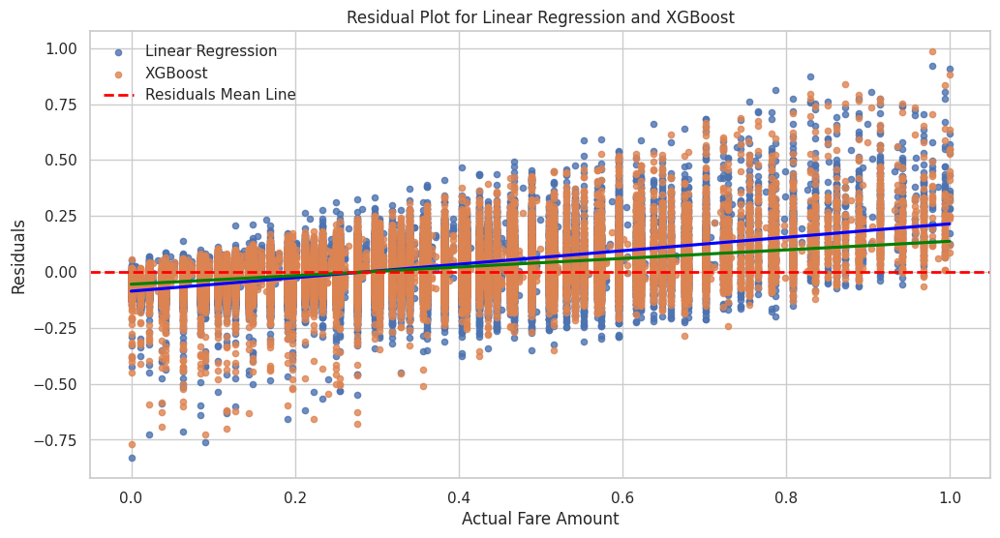

In [130]:
# Calculate residuals for Linear Regression
residuals_lr = y_test.flatten() - lr_pred.flatten()

# Calculate residuals for XGBoost
residuals_xgb = y_test.flatten() - y_XGB_predict.flatten()

# Create a scatter plot for Linear Regression
plt.figure(figsize=(12, 6))
sns.regplot(x=y_test.flatten(), y=residuals_lr, scatter_kws={"s": 20}, line_kws={"color": "blue"}, label="Linear Regression")

# Create a scatter plot for XGBoost
sns.regplot(x=y_test.flatten(), y=residuals_xgb, scatter_kws={"s": 20}, line_kws={"color": "green"}, label="XGBoost")

plt.xlabel("Actual Fare Amount")
plt.ylabel("Residuals")
plt.title("Residual Plot for Linear Regression and XGBoost")
plt.axhline(0, color='red', linestyle='--', linewidth=2, label="Residuals Mean Line")
plt.legend()
plt.grid(True)
plt.show()


In [131]:
# Assuming you have the true values in y_test for all models
y_true = y_test.flatten()

# Assuming you have predictions for all models
predictions = [lr_pred, poly_pred, rf_pred, dt_pred, y_XGB_predict]
model_names = ['Linear Regression', 'Polynomial Regression', 'Random Forest', 'Decision Tree', 'XGBoost']

# Initialize lists to store metrics
r2_scores = []
mse_scores = []
rmse_scores = []

# Calculate metrics for each model
for prediction in predictions:
    r2_scores.append(r2_score(y_true, prediction))
    mse_scores.append(mean_squared_error(y_true, prediction))
    rmse_scores.append(sqrt(mean_squared_error(y_true, prediction)))

# Create the DataFrame
model_comparison_df = pd.DataFrame({
    'Model': model_names,
    'R2 Score': r2_scores,
    'MSE': mse_scores,
    'RMSE': rmse_scores
})

# Display or use the DataFrame as needed
model_comparison_df

,Model,R2 Score,MSE,RMSE
0,Linear Regression,0.701875,0.012154,0.110245
1,Polynomial Regression,0.756072,0.009944,0.099722
2,Random Forest,0.793746,0.008409,0.091698
3,Decision Tree,0.576770,0.017254,0.131356
4,XGBoost,0.808111,0.007823,0.088447


In [132]:
import plotly.express as px

# Sample data (replace with your actual data)
lr_mse=metrics.mean_squared_error(y_test, lr_pred)
poly_mse=metrics.mean_squared_error(y_test, poly_pred)
rf_mse=metrics.mean_squared_error(y_test, rf_pred)
dt_mse=metrics.mean_squared_error(y_test, dt_pred)
xgb_mse=metrics.mean_squared_error(y_test, y_XGB_predict)

data = {
    'Model': ['Linear Regression', 'Polynomial Regression', 'Random Forest', 'Decision Tree', 'XGBoost'],
    'MSE': [lr_mse,poly_mse , rf_mse,  dt_mse, xgb_mse]
}

# Create a DataFrame from the data
df = pd.DataFrame(data)

# Create an interactive bar plot with Plotly
fig = px.bar(df, x='MSE', y='Model', text='MSE', color='MSE',
             labels={'MSE': 'Mean Squared Error (MSE)'},
             title='Comparison of MSE Across Models',
             color_continuous_scale=px.colors.sequential.Viridis)

# Customize the appearance of the plot
fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(xaxis_title=None, yaxis_title=None, coloraxis_showscale=False)
fig.update_xaxes(title_font=dict(size=14))
fig.update_yaxes(title_font=dict(size=14))
fig.update_layout(title_font=dict(size=16), font=dict(size=12))

# Show the interactive plot
fig.show()

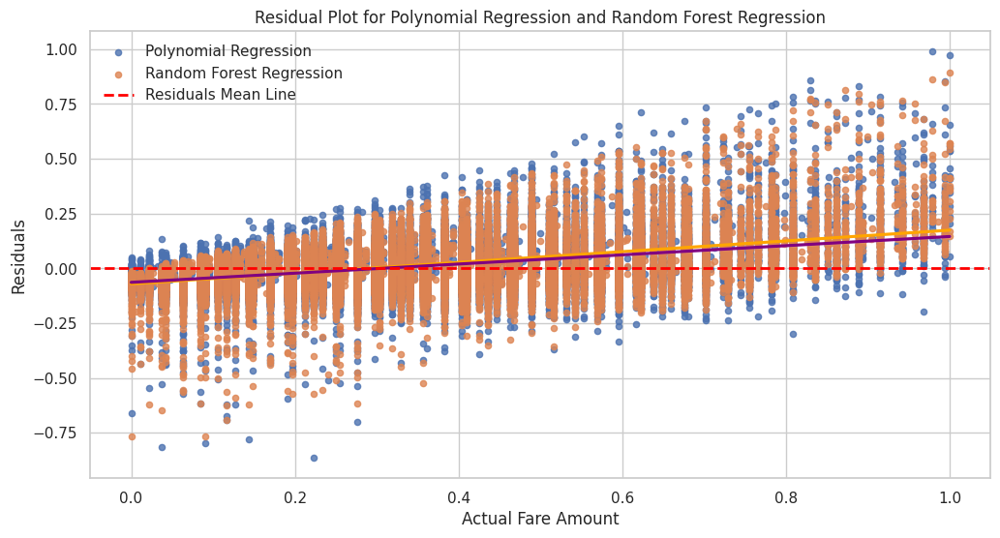

In [133]:
# Calculate residuals for Polynomial Regression
residuals_poly = y_test.flatten() - poly_pred.flatten()  # Flatten to make them 1D

# Calculate residuals for Random Forest Regression
residuals_rf = y_test.flatten() - rf_pred.flatten()  # Flatten to make them 1D

# Create a scatter plot for Polynomial Regression
plt.figure(figsize=(12, 6))
sns.regplot(x=y_test.flatten(), y=residuals_poly, scatter_kws={"s": 20}, line_kws={"color": "orange"}, label="Polynomial Regression")

# Create a scatter plot for Random Forest Regression
sns.regplot(x=y_test.flatten(), y=residuals_rf, scatter_kws={"s": 20}, line_kws={"color": "purple"}, label="Random Forest Regression")

plt.xlabel("Actual Fare Amount")
plt.ylabel("Residuals")
plt.title("Residual Plot for Polynomial Regression and Random Forest Regression")
plt.axhline(0, color='red', linestyle='--', linewidth=2, label="Residuals Mean Line")
plt.legend()
plt.grid(True)
plt.show()

# Save Model

In [134]:
import pickle
pickle.dump(xgb_model, open('model.pkl', 'wb'))
pickle.dump(X_scaler, open('x_scaler.pkl', 'wb'))
pickle.dump(y_scaler, open('y_scaler.pkl', 'wb'))

In [135]:
import pickle
pickle.dump(xgb_model, open('model.sav', 'wb'))

In [136]:
import joblib
joblib.dump(X_scaler, "x_scaler.joblib")
joblib.dump(y_scaler, "y_scaler.joblib")

['y_scaler.joblib']

In [137]:
joblib.dump(xgb_model, "model.joblib")

['model.joblib']

In [138]:
pickle.dump(X_train.columns.tolist(), open('columns.sav', 'wb'))

In [139]:
mod = joblib.load("model.joblib")
pred = mod.predict(X_test)
mse = mean_squared_error(y_test, pred)
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, pred))
print("r2 score = ", r2_score(y_test, pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, pred)))

Mean Squared Error (MSE): 0.007822931712006128
r2 score =  0.8081113778719573
Root Mean Squared Error (RMSE): 0.08844733863721467


In [140]:
y_test

array([[0.70212766],
       [0.11702128],
       [0.14893617],
       ...,
       [0.23404255],
       [0.32978723],
       [0.14893617]])

In [141]:
sc = joblib.load("y_scaler.joblib")
sc.inverse_transform(y_test)

array([[16.5],
       [ 5.5],
       [ 6.1],
       ...,
       [ 7.7],
       [ 9.5],
       [ 6.1]])

[Go to Top](#top)